# Tracking Image Features

## 1. Intensity Gradient and Filtering

> Project code in `gradien_filtering` folder

### a) Locating Keypoints in an Image
As discussed in the previous lesson, a camera is not able to measure distance to an object directly. However, for our collision avoidance system, we can compute time-to-collision based on relative distance ratios on the image sensor instead. To do so, we need a set of locations on the image plane which can serve as stable anchors to compute relative distances between them. This section discussed how to locate such anchor locations - or ***keypoints*** in an image.

Take a look at the three patches in the following figure which have been extracted from an image of a highway driving scene. The grid shows the borders of individual pixels. How would you describe meaningful locations within those patches that could be used as keypoints?

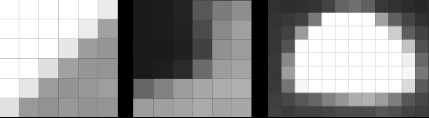

In the leftmost patch, there is a distinctive contrast between bright and dark pixels which resembles a line from the bottom-left to the upper-right. The patch in the middle resembles a corner formed by a group of very dark pixels in the upper-left. The rightmost patch looks like a bright blob that might be approximated by an ellipse.

In order to precisely locate a keypoint in an image, we need a way to assign them a unique coordinate in both x an y. Not all of the above patches lend themselves to this goal. Both the corner as well as the ellipse can be positioned accurately in x and y, the line in the leftmost image can not.

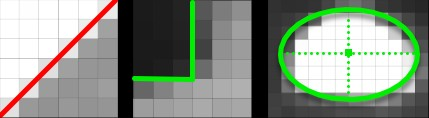

In the following, we will thus concentrate on detecting corners in an image. In a later section, we will also look at detector who are optimized for blob-like structures, such as the ***SIFT detector***.

### b) The Intensity Gradient
In the above examples, the contrast between neighboring pixels contains the information we need : In order to precisely locate e.g. the corner in the middle patch, we do not need to know its color but instead we require the color difference between the pixels that form the corner to be as high as possible. An ideal corner would consist of only black and white pixels.

The figure below shows the intensity profile of all pixels along the red line in the image as well as the intensity gradient, which is the derivative of image intensity.

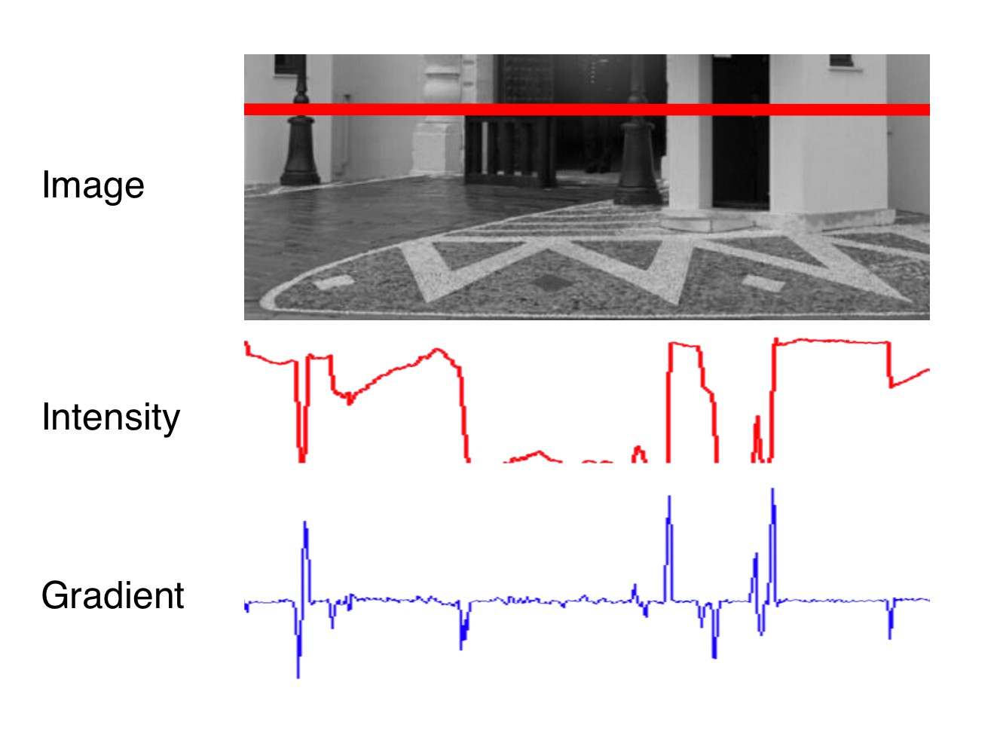

Adapted from https://cs.brown.edu/courses/cs143/lectures_Fall2017/07_Fall2017_EdgeDetection.pdf

It can be seen that the intensity profile increases rapidly at positions where the contrast between neighboring pixels changes significantly. The lower part of the street lamp on the left side and the dark door show a distinct intensity difference to the light wall. If we wanted to assign unique coordinates to the pixels where the change occurs, we could do so by looking at the derivative of the intensity, which is the blue gradient profile you can see below the red line. Sudden changes in image intensity are clearly visible as distinct peaks and valleys in the gradient profile. If we were to look for such peaks not only from left to right but also from top to bottom, we could look for points which show a gradient peak both in horizontal and in vertical direction and choose them as keypoints with both x and y coordinates. In the example patches above, this would work best for the corner, whereas an edge-like structure would have more or less identical gradients at all positions with no clear peak in x and y.

Based on the above observations, the first step into keypoint detection is thus the computation of a gradient image. Mathematically, the gradient is the partial derivative of the image intensity into both x and y direction. The figure below shows the intensity gradient for three example patches. The gradient direction is represented by the arrow.

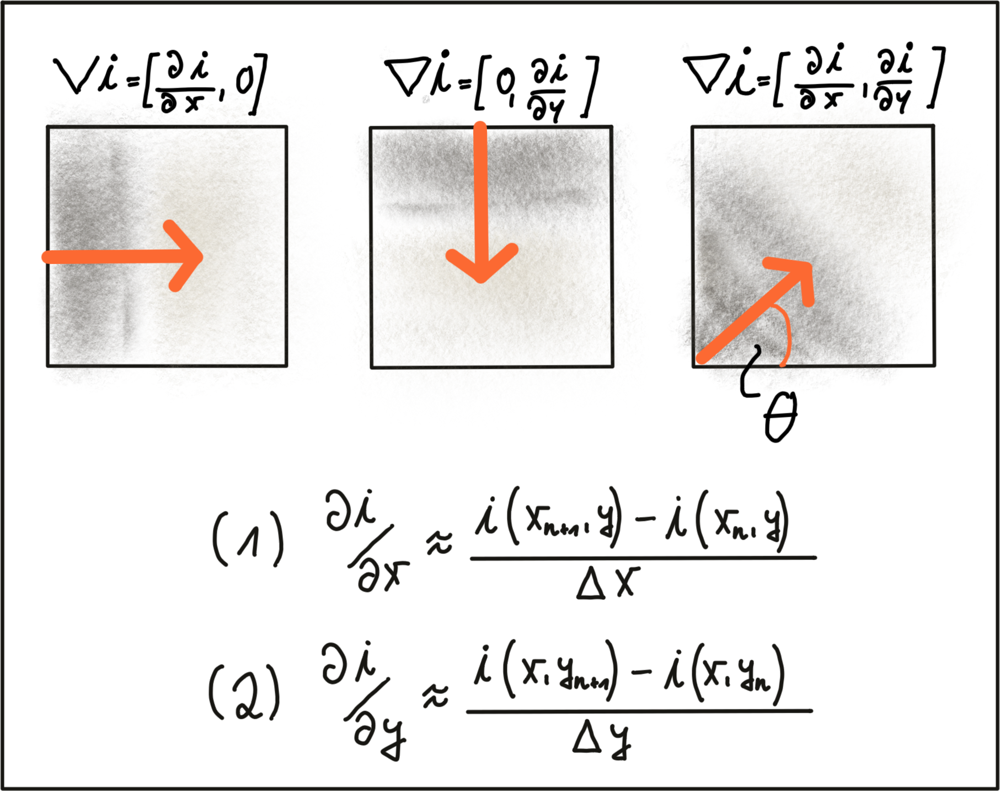

In equations (1) and (2), the intensity gradient is approximated by the intensity differences between neighboring pixels, divided by the distance between those pixels in x- and y-direction. Next, based on the intensity gradient vector, we can compute both the direction as well as the magnitude as given by the following equations:

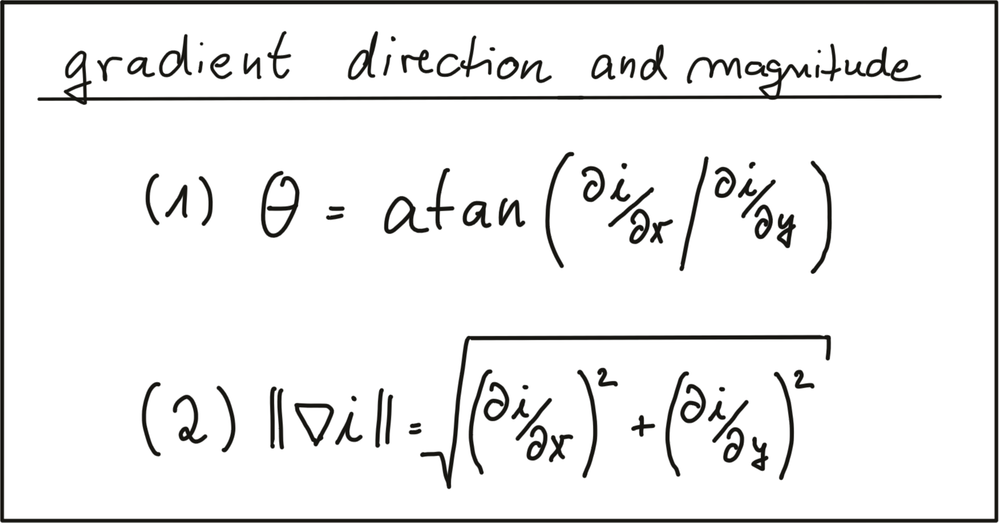

There are numerous ways of computing the intensity gradient. The most straightforward approach would be to simply compute the intensity difference between neighboring pixels. This approach however is extremely sensitive to noise and should be avoided in practice. Further down in this section, we will look at a well-proven standard approach, the ***Sobel operator***.

### c) Image Filters and Gaussian Smoothing
Before we further discuss gradient computation, we need to think about noise, which is present in all images (except artificial ones) and which decreases with increasing light intensity. To counteract noise, especially under low-light conditions, a smoothing operator has to be applied to the image before gradient computation. Usually, a Gaussian filter is used for this purpose which is shifted over the image and combined with the intensity values beneath it. In order to parameterize the filter properly, two parameters have to be adjusted:

1. The standard deviation, which controls the spatial extension of the filter in the image plane. The larger the standard deviation, the wider the area which is covered by the filter.
2. The kernel size, which defines how many pixels around the center location will contribute to the smoothing operation.

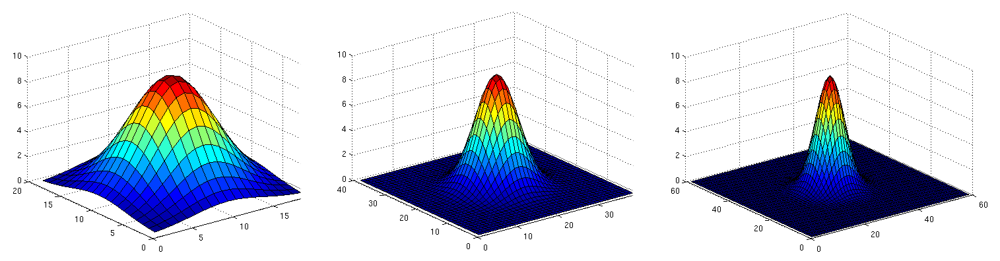

Gaussian smoothing works by assigning each pixel a weighted sum of the surrounding pixels based on the height of the Gaussian curve at each point. The largest contribution will come from the center pixel itself, whereas the contribution from the pixels surroundings will decrease depending on the height of the Gaussian curve and thus its standard deviation. It can easily be seen that the contribution of the surrounding pixels around the center location increases when the standard deviation is large (left image).

Applying the Gaussian filter (or any other filter) works in four successive steps which are illustrated by the figure below:

1. Create a filter kernel with the desired properties (e.g. Gaussian smoothing or edge detection)
2. Define the anchor point within the kernel (usually the center position) and place it on top of the first pixel of the image.
3. Compute the sum of the products of kernel coefficients with the corresponding image pixel values beneath.
4. Place the result to the location of the kernel anchor in the input image.
5. Repeat the process for all pixels over the entire image.

The following figure illustrates the process of shifting the (yellow) filter kernel over the image row by row and assigning the result of the two-dimensional sum H(x,y) to every pixel location.

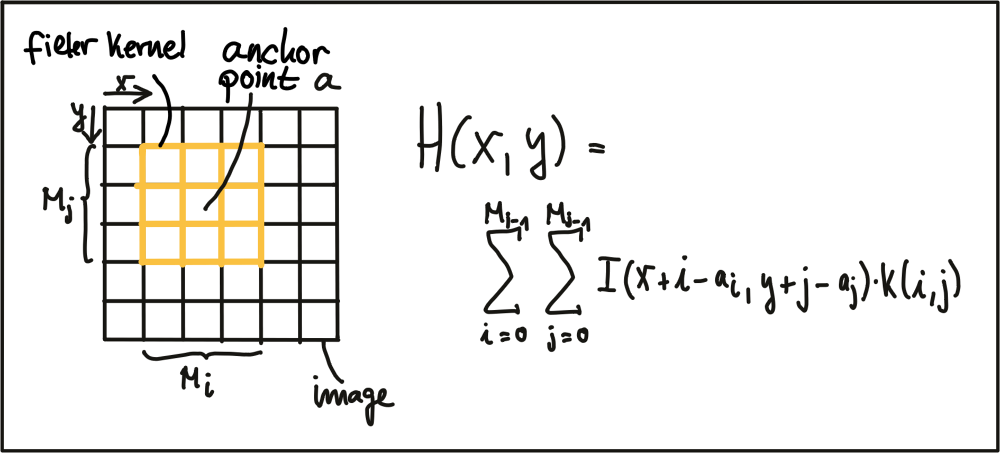

A filter kernel for Gaussian smoothing is shown in the next figure. In (a), a 3D Gaussian curve is shown and in (b), the corresponding discrete filter kernel can be seen with a central anchor point (41) corresponding to the maximum of the Gaussian curve and with decreasing values towards the edges in a (approximately) circular shape.

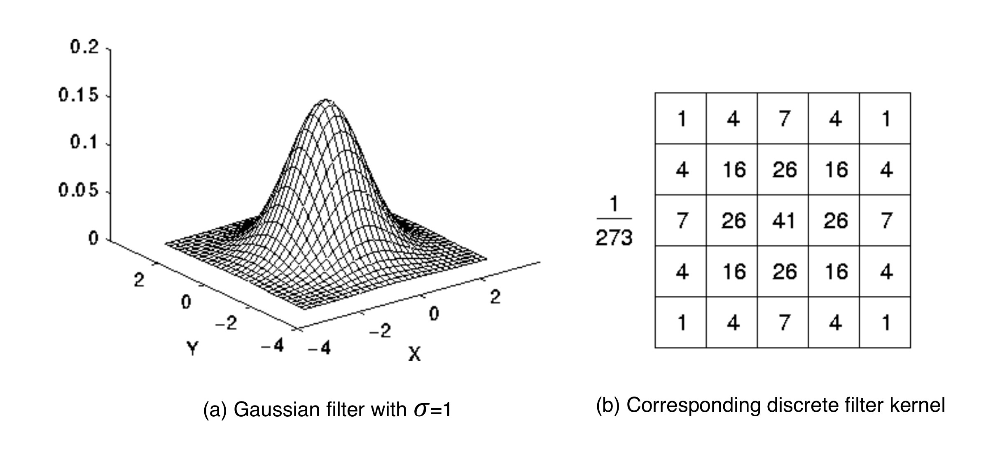
https://homepages.inf.ed.ac.uk/rbf/HIPR2/gsmooth.htm

```c++
void gaussianSmoothing1()
{
    // load image from file
    cv::Mat img;
    img = cv::imread("../images/img1gray.png");

    // create filter kernel
    float gauss_data[25] = {1, 4, 7, 4, 1,
                            4, 16, 26, 16, 4,
                            7, 26, 41, 26, 7,
                            4, 16, 26, 16, 4,
                            1, 4, 7, 4, 1};
    cv::Mat kernel = cv::Mat(5, 5, CV_32F, gauss_data);

    for (int i = 0; i < 25; i++)
    {
        gauss_data[i] /= 273;
    }

    // apply filter
    cv::Mat result;
    cv::filter2D(img, result, -1, kernel, cv::Point(-1, -1), 0, cv::BORDER_DEFAULT);

    // show result
    string windowName = "Gaussian Blurring";
    cv::namedWindow(windowName, 1); // create window
    cv::imshow(windowName, result);
    cv::waitKey(0); // wait for keyboard input before continuing
}
```

The above code is meant to illustrate the principle of filters and of Gaussian blurring. In your projects however, you can (and should) use the function `cv::GaussianBlur`, which lets you change the standard deviation easily without having to adjust the filter kernel.

### d) Computing the Intensity Gradient
After smoothing the image slightly to reduce the influence of noise, we can now compute the intensity gradient of the image in both x and y direction. In the literature, there are several approaches to gradient computation to be found. Among the most famous it the `Sobel` operator (proposed in 1968), but there are several others, such as the `Scharr` operator, which is optimized for rotational symmetry.

The ***Sobel*** operator is based on applying small integer-valued filters both in horizontal and vertical direction. The operators are 3x3 kernels, one for the gradient in x and one for the gradient in y. Both kernels are shown below.

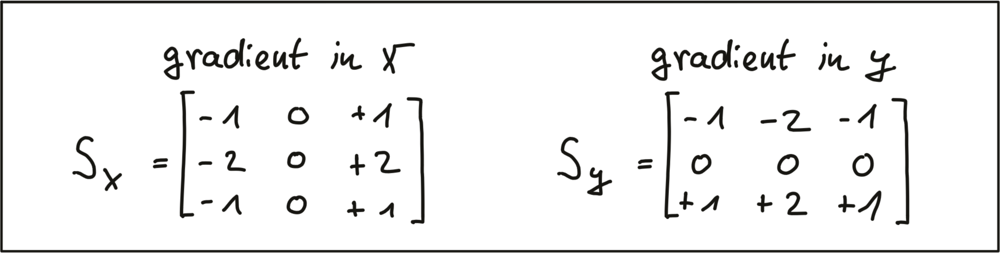

In the following code, one kernel of the Sobel operator is applied to an image. Note that it has been converted to grayscale to avoid computing the operator on each color channel. This code can be found in the `gradient_sobel.cpp` file in the desktop workspace above. You can run the code by using the `gradient_sobel` executable.

```c++
// load image from file
cv::Mat img;
img = cv::imread("./img1.png");

// convert image to grayscale
cv::Mat imgGray;
cv::cvtColor(img, imgGray, cv::COLOR_BGR2GRAY);

// create filter kernel
float sobel_x[9] = {-1, 0, +1,
                    -2, 0, +2, 
                    -1, 0, +1};
cv::Mat kernel_x = cv::Mat(3, 3, CV_32F, sobel_x);

// apply filter
cv::Mat result_x;
cv::filter2D(imgGray, result_x, -1, kernel_x, cv::Point(-1, -1), 0, cv::BORDER_DEFAULT);

// show result
string windowName = "Sobel operator (x-direction)";
cv::namedWindow( windowName, 1 ); // create window 
cv::imshow(windowName, result_x);
cv::waitKey(0); // wait for keyboard input before continuing
```

The resulting gradient image is shown below. It can be seen that areas of strong local contrast such as the cast shadow of the preceding vehicle leads to high values in the filtered image.

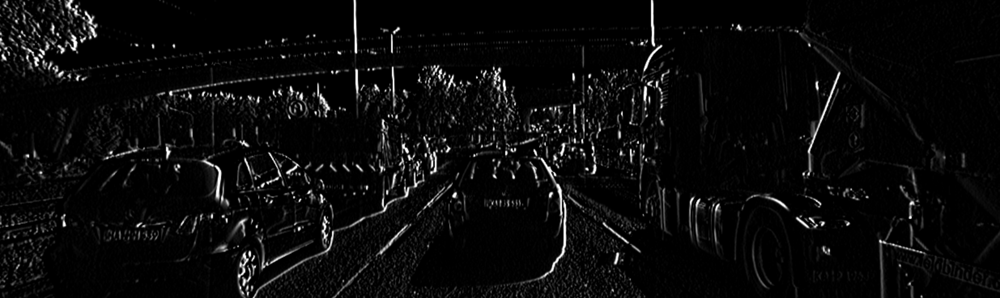

Note that in the above code, only the Sx filter kernel has been applied for now, which is why the cast shadow only shows in x direction. Applying Sy to the image yields the following result:

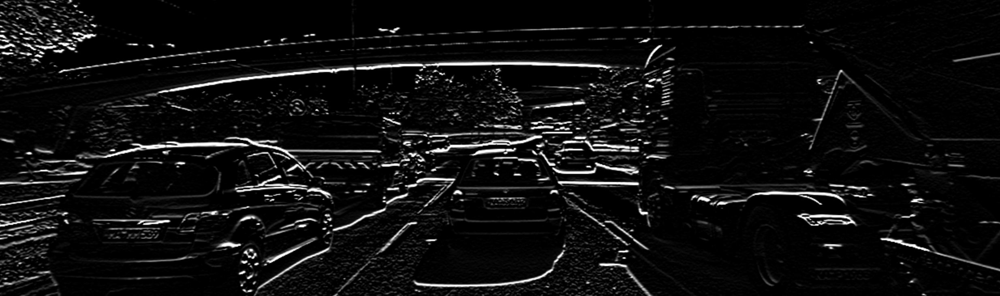

Based on the image gradients in both x and y, compute an image which contains the gradient magnitude according to the equation at the beginning of this section for every pixel position. Also, apply different levels of Gaussian blurring before applying the Sobel operator and compare the results.

You can use the `magnitude_sobel.cpp` file in the desktop workspace above for your solution, and after `make`, you can run the code using the `magnitude_sobel` executable.

The result should look something like this, with the noise in the road surface being almost gone due to smoothing:

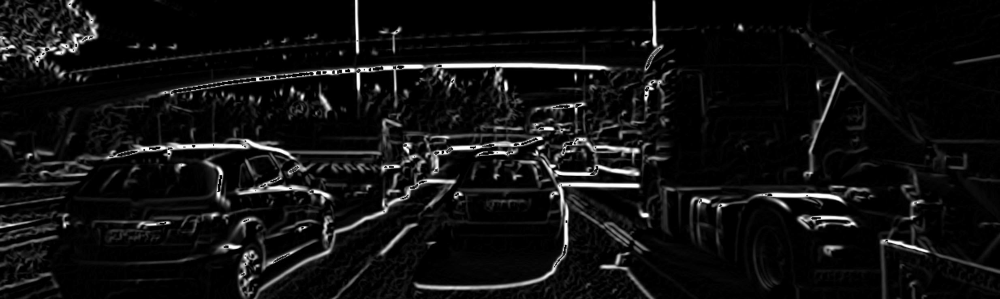

```c++
void magnitudeSobel()
{
    // load image from file
    cv::Mat img;
    img = cv::imread("../images/img1gray.png");

    // convert image to grayscale
    cv::Mat imgGray;
    cv::cvtColor(img, imgGray, cv::COLOR_BGR2GRAY);

    // apply smoothing
    cv::Mat blurred = imgGray.clone();
    int filterSize = 5;
    int stdDev = 2.0;
    cv::GaussianBlur(imgGray, blurred, cv::Size(filterSize, filterSize), stdDev);

    // create filter kernels
    float sobel_x[9] = {-1, 0, +1, -2, 0, +2, -1, 0, +1};
    cv::Mat kernel_x = cv::Mat(3, 3, CV_32F, sobel_x);

    float sobel_y[9] = {-1, -2, -1, 0, 0, 0, +1, +2, +1};
    cv::Mat kernel_y = cv::Mat(3, 3, CV_32F, sobel_y);

    // apply filter
    cv::Mat result_x, result_y;
    cv::filter2D(blurred, result_x, -1, kernel_x, cv::Point(-1, -1), 0, cv::BORDER_DEFAULT);
    cv::filter2D(blurred, result_y, -1, kernel_y, cv::Point(-1, -1), 0, cv::BORDER_DEFAULT);

    // compute magnitude image
    cv::Mat magnitude = imgGray.clone();
    for (int r = 0; r < magnitude.rows; r++)
    {
        for (int c = 0; c < magnitude.cols; c++)
        {
            magnitude.at<unsigned char>(r, c) = sqrt(pow(result_x.at<unsigned char>(r, c), 2) +
                                                     pow(result_y.at<unsigned char>(r, c), 2));
        }
    }

    // show result
    string windowName = "Gaussian Blurring";
    cv::namedWindow(windowName, 1); // create window
    cv::imshow(windowName, magnitude);
    cv::waitKey(0); // wait for keyboard input before continuing
}
```


## 2. Harris Corner Detection

> Project code in `cornerness_harris` folder

### a) Local Measures of Uniqueness
The idea of keypoint detection is to detect a unique structure in an image that can be precisely located in both coordinate directions. As discussed in the previous section, corners are ideally suited for this purpose. To illustrate this, the following figure shows an image patch which consists of line structures on a homogeneously colored background. A red arrow indicates that no unique position can be found in this direction. The green arrow expresses the opposite. As can be seen, the corner is the only local structure that can be assigned a unique coordinate in x and y.

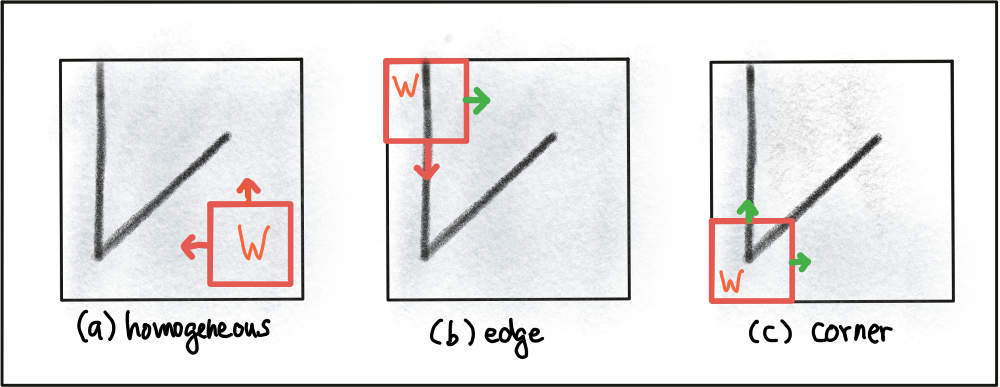

In order to locate a corner, we consider how the content of the window would change when shifting it by a small amount. For case (a) in the figure above, there is no measurable change in any coordinate direction at the current location of the red window W whereas for (b), there will be significant change into the direction orthogonal to the edge and no change when moving into the direction of the edge. In case of (c), the window content will change in any coordinate direction.

The idea of locating corners by means of an algorithm is to find a way to detect areas with a significant change in the image structure based on a displacement of a local window W. Generally, a suitable measure for describing change mathematically is the **sum of squared differences** (SSD), which looks at the deviations of all pixels in a local neighborhood before and after performing a coordinate shift. The equation below illustrates the concept.

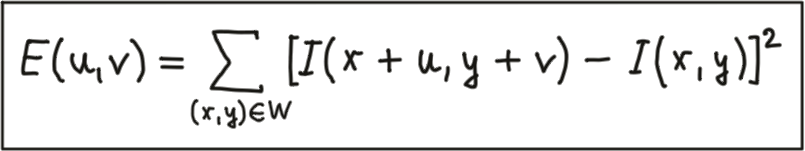

After shifting the Window W by an amount u in x-direction and v in y-direction the equation sums up the squared differences of all pixels within W at the old and at the new window position. In the following we will use some mathematical transformations to derive a measure for the change of the local environment around a pixel from the general definition of the SSD.

In the first step, based on the definition of E(u,v) above, we will at first make a Taylor series expansion of I(x+u, y+u). For small values of u and v, the first-order approximation is sufficient, which leads to the following expression.

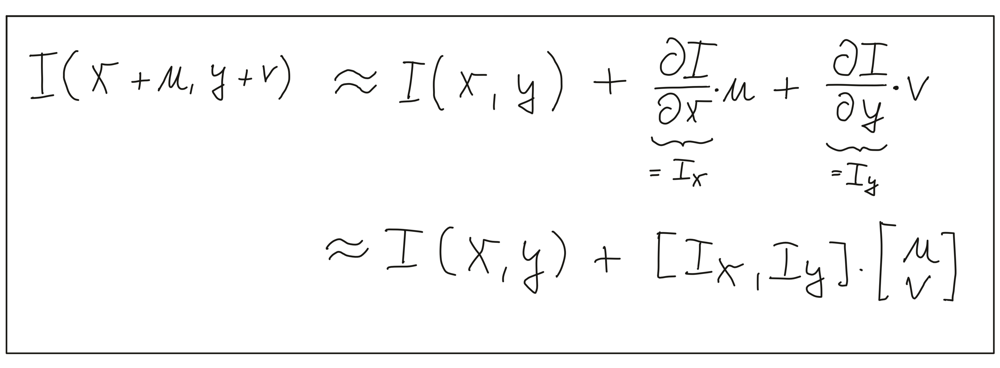

The derivation of the image intensity II both in x- and y-direction is something you have learned in the previous section already - this is simply the intensity gradient . From this point on, we will use the shorthand notation shown above to express the gradient.

In the second step, we will now insert the approximated expression of I(x+u, y+v)I(x+u,y+v) into the SSD equation above, which simplifies to the following form:

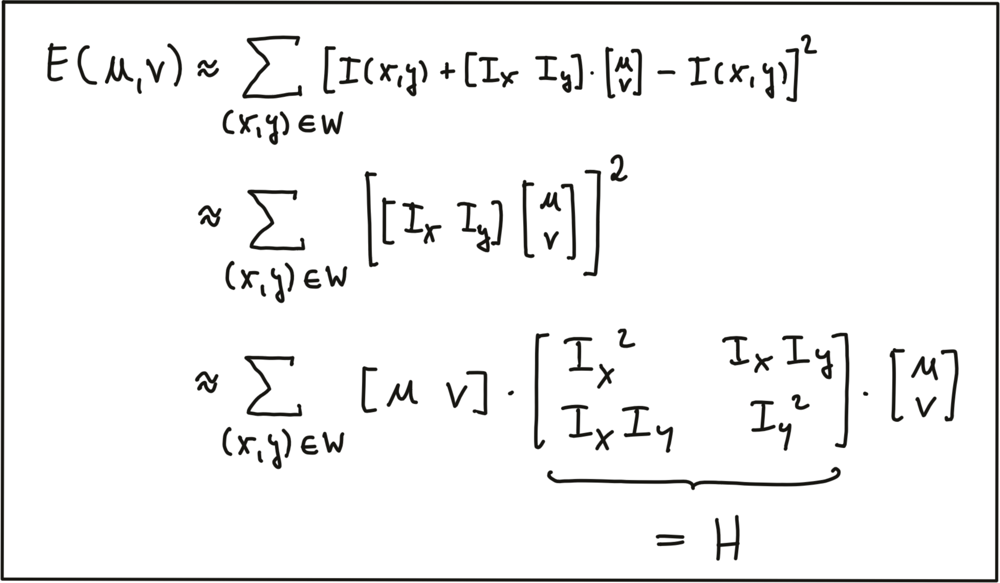

The result of our mathematical transformations is a matrix H, which can now be conveniently analyzed to locate structural change in a local window W around every pixel position u,v in an image. In the literature, the matrix H is often referred to as covariance matrix.

To do this, it helps to visualize the matrix H as an ellipse, whose axis length and directions are given by its eigenvalues and eigenvectors. As can be seen in the following figure, the larger eigenvector points into the direction of maximal intensity change, whereas the smaller eigenvector points into the direction of minimal change. So in order to identify corners, we need to find positions in the image which have two significantly large eigenvalues of H.

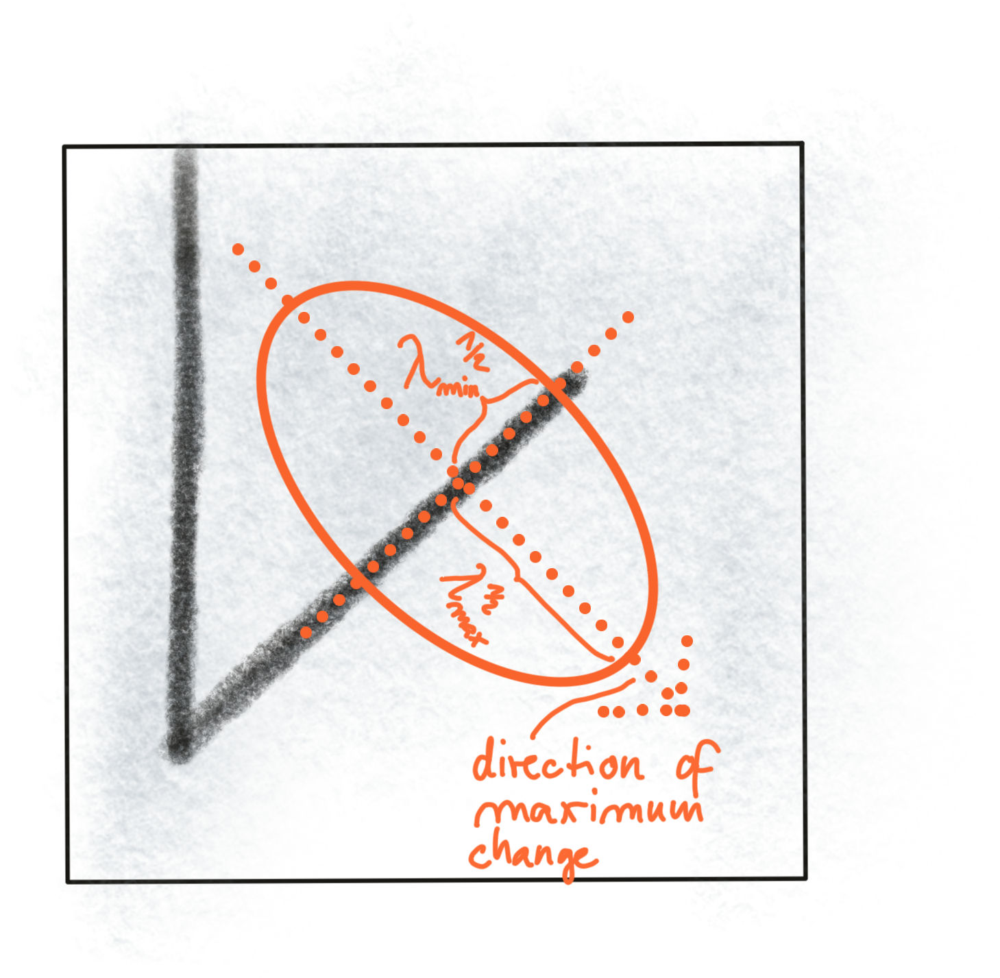

Without going into details on eigenvalues in this course, we will look at a simple formula of how they can be computed from H:

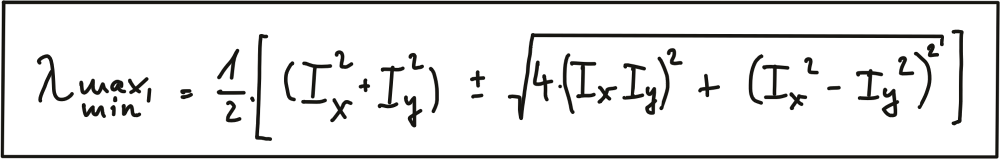

In addition to the smoothing of the image before gradient computation, the Harris detector uses a Gaussian window w(x,y) to compute a weighted sum of the intensity gradients around a local neighborhood. The size of this neighborhood is called **scale** in the context of feature detection and it is controlled by the **standard deviation** of the Gaussian distribution.

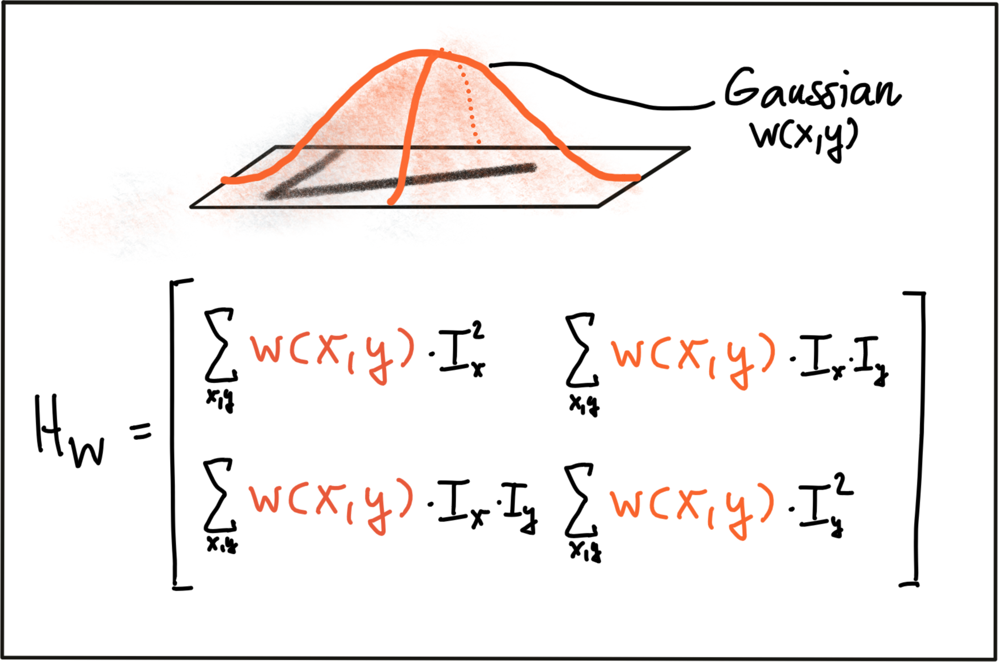

As can be seen, the larger the scale of the Gaussian window, the larger the feature below that contributes to the sum of gradients. By adjusting scale, we can thus control the keypoints we are able to detect.

### b) The Harris Corner Detector
Based on the eigenvalues of H, one of the most famous corner detectors is the Harris detector. This method evaluates the following expression to derive a corner response measure at every pixel location with the factor k being an empirical constant which is usually in the range between ***k = 0.04 - 0.06***.

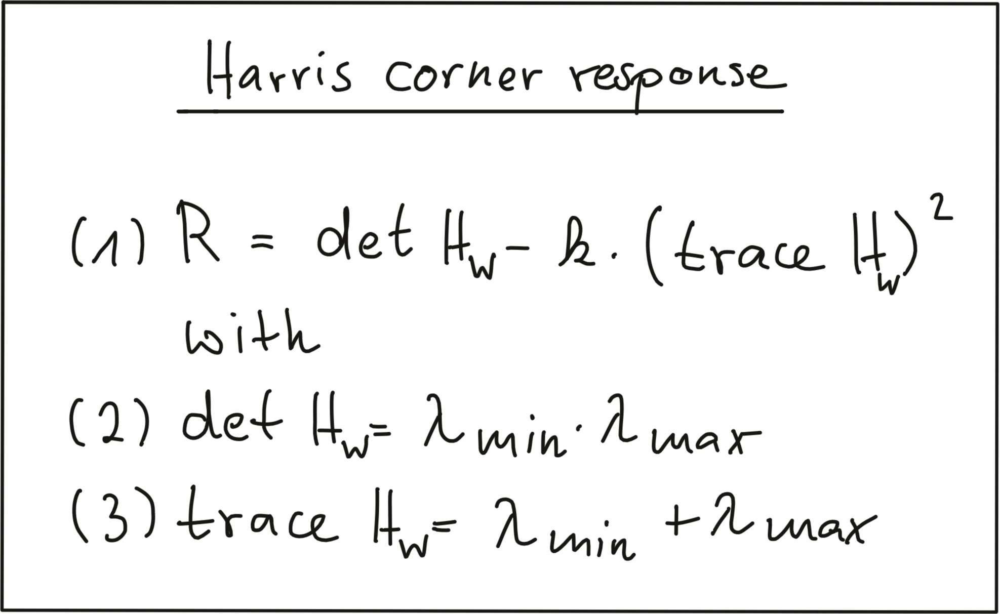

Based on the concepts presented in this section, the following code computes the corner response for a given image and displays the result.

```c++
// load image from file
cv::Mat img;
img = cv::imread("./img1.png");

// convert image to grayscale
cv::Mat imgGray; 
cv::cvtColor(img, imgGray, cv::COLOR_BGR2GRAY);

// Detector parameters
int blockSize = 2; // for every pixel, a blockSize × blockSize neighborhood is considered
int apertureSize = 3; // aperture parameter for Sobel operator (must be odd)
int minResponse = 100; // minimum value for a corner in the 8bit scaled response matrix
double k = 0.04; // Harris parameter (see equation for details)

// Detect Harris corners and normalize output
cv::Mat dst, dst_norm, dst_norm_scaled;
dst = cv::Mat::zeros(imgGray.size(), CV_32FC1 );
cv::cornerHarris( imgGray, dst, blockSize, apertureSize, k, cv::BORDER_DEFAULT ); 
cv::normalize( dst, dst_norm, 0, 255, cv::NORM_MINMAX, CV_32FC1, cv::Mat() );
cv::convertScaleAbs( dst_norm, dst_norm_scaled );

// visualize results
string windowName = "Harris Corner Detector Response Matrix";
cv::namedWindow( windowName, 4 );
cv::imshow( windowName, dst_norm_scaled );
cv::waitKey(0);
```

The result can be seen below : The brighter a pixel, the higher the Harris corner response.

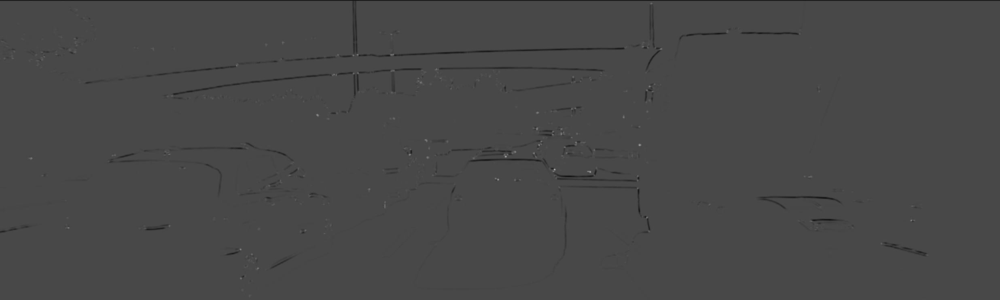

### c) Exercise
In order to locate corners, we now have to perform a non-maxima suppression to (a) ensure that we get the pixel with maximum cornerness in a local neighborhood and (b) to prevent corners from being too close to each other as we prefer an even spread of corners throughout the image.

Your task is to locate local maxima in the Harris response matrix and perform a **non-maximum suppression** (NMS) in a local neighborhood around each maximum. The resulting coordinates shall be stored in a list of keypoints of the type `vector<cv::KeyPoint>`. The result should look like this, with each circle denoting the position of a Harris corner.

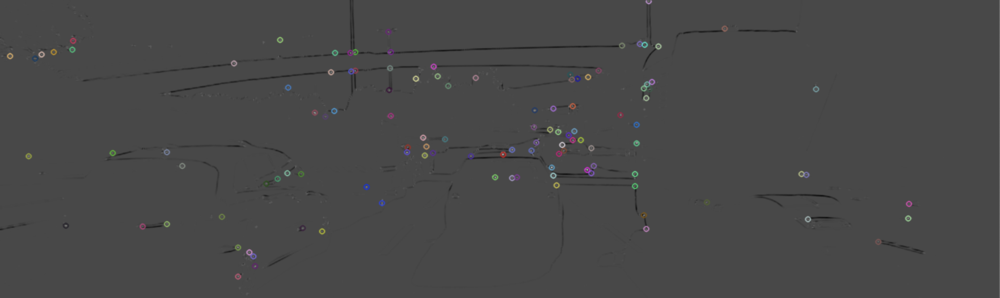

```c++
void cornernessHarris()
{
    // load image from file
    cv::Mat img;
    img = cv::imread("../images/img1.png");
    cv::cvtColor(img, img, cv::COLOR_BGR2GRAY); // convert to grayscale

    // Detector parameters
    int blockSize = 2;     // for every pixel, a blockSize × blockSize neighborhood is considered
    int apertureSize = 3;  // aperture parameter for Sobel operator (must be odd)
    int minResponse = 100; // minimum value for a corner in the 8bit scaled response matrix
    double k = 0.04;       // Harris parameter (see equation for details)

    // Detect Harris corners and normalize output
    cv::Mat dst, dst_norm, dst_norm_scaled;
    dst = cv::Mat::zeros(img.size(), CV_32FC1);
    cv::cornerHarris(img, dst, blockSize, apertureSize, k, cv::BORDER_DEFAULT);
    cv::normalize(dst, dst_norm, 0, 255, cv::NORM_MINMAX, CV_32FC1, cv::Mat());
    cv::convertScaleAbs(dst_norm, dst_norm_scaled);

    // visualize results
    string windowName = "Harris Corner Detector Response Matrix";
    cv::namedWindow(windowName, 4);
    cv::imshow(windowName, dst_norm_scaled);
    cv::waitKey(0);

    // TODO: Your task is to locate local maxima in the Harris response matrix 
    // and perform a non-maximum suppression (NMS) in a local neighborhood around 
    // each maximum. The resulting coordinates shall be stored in a list of keypoints 
    // of the type `vector<cv::KeyPoint>`.
	// STUDENTS NEET TO ENTER THIS CODE (C3.2 Atom 4)

    // Look for prominent corners and instantiate keypoints
    vector<cv::KeyPoint> keypoints;
    double maxOverlap = 0.0; // max. permissible overlap between two features in %, used during non-maxima suppression
    for (size_t j = 0; j < dst_norm.rows; j++)
    {
        for (size_t i = 0; i < dst_norm.cols; i++)
        {
            int response = (int)dst_norm.at<float>(j, i);
            if (response > minResponse)
            { // only store points above a threshold

                cv::KeyPoint newKeyPoint;
                newKeyPoint.pt = cv::Point2f(i, j);
                newKeyPoint.size = 2 * apertureSize;
                newKeyPoint.response = response;

                // perform non-maximum suppression (NMS) in local neighbourhood around new key point
                bool bOverlap = false;
                for (auto it = keypoints.begin(); it != keypoints.end(); ++it)
                {
                    double kptOverlap = cv::KeyPoint::overlap(newKeyPoint, *it);
                    if (kptOverlap > maxOverlap)
                    {
                        bOverlap = true;
                        if (newKeyPoint.response > (*it).response)
                        {                      // if overlap is >t AND response is higher for new kpt
                            *it = newKeyPoint; // replace old key point with new one
                            break;             // quit loop over keypoints
                        }
                    }
                }
                if (!bOverlap)
                {                                     // only add new key point if no overlap has been found in previous NMS
                    keypoints.push_back(newKeyPoint); // store new keypoint in dynamic list
                }
            }
        } // eof loop over cols
    }     // eof loop over rows

    // visualize keypoints
    windowName = "Harris Corner Detection Results";
    cv::namedWindow(windowName, 5);
    cv::Mat visImage = dst_norm_scaled.clone();
    cv::drawKeypoints(dst_norm_scaled, keypoints, visImage, cv::Scalar::all(-1), cv::DrawMatchesFlags::DRAW_RICH_KEYPOINTS);
    cv::imshow(windowName, visImage);
    cv::waitKey(0);
    // EOF STUDENT CODE
}
```


## 3. Overview of Popular Keypoint Detectors

> Project code in `detect_keypoints` folder

### a) Invariance to Photometric and Geometric Changes
In the literature (and in the OpenCV library), there is a large number of feature detectors (including the Harris detector), we can choose from. Depending on the type of keypoint that shall be detected and based on the properties of the images, the robustness of the respective detector with regard to both photometric and geometric transformations needs to be considered.

There are four basic transformation types we need to think about when selecting a suitable keypoint detector:

1. Rotation
2. Scale change
3. Intensity change
4. Affine transformation

The following figure shows two images in frame i of a video sequence (a) who have been subjected to several transformations in frame i + n (b).

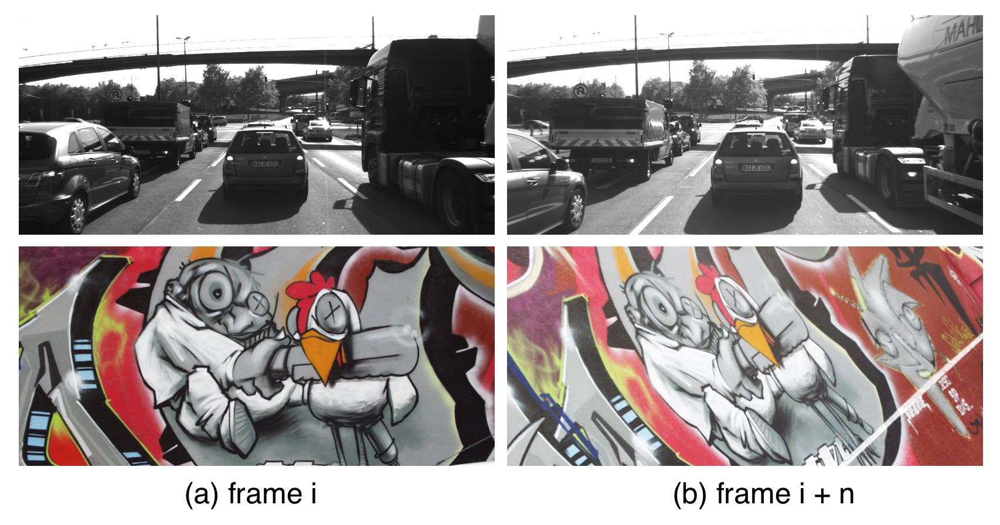

For the graffiti sequence, which is one of the standard image sets used in computer vision (also see http://www.robots.ox.ac.uk/~vgg/research/affine/), we can observe all of the transformations listed above whereas for the highway sequence, when focussing on the preceding vehicle, there is only a scale change as well as an intensity change between frames i and i+n.

In the following, the above criteria are used to briefly assess the Harris corner detector.

Rotation R :
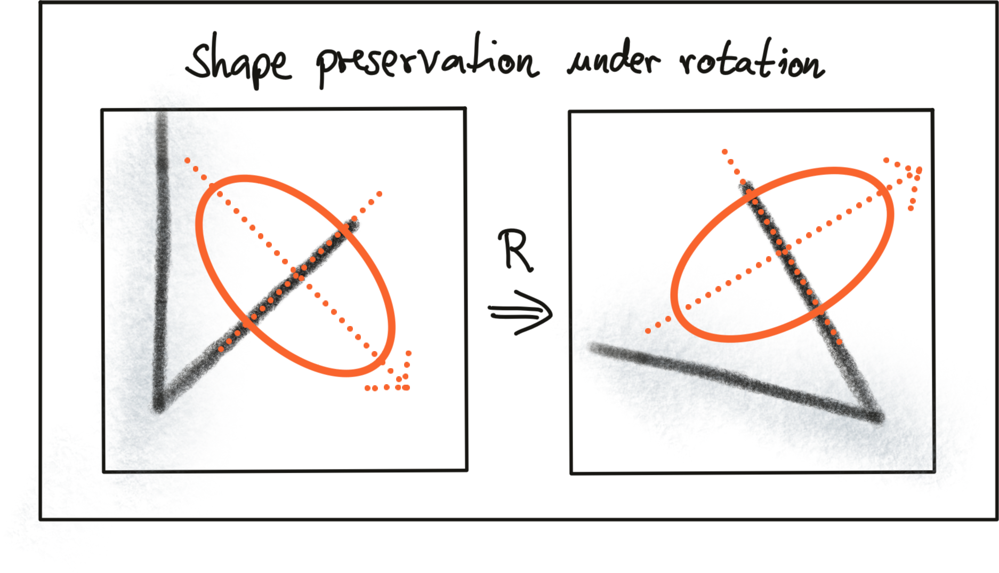

Intensity change:

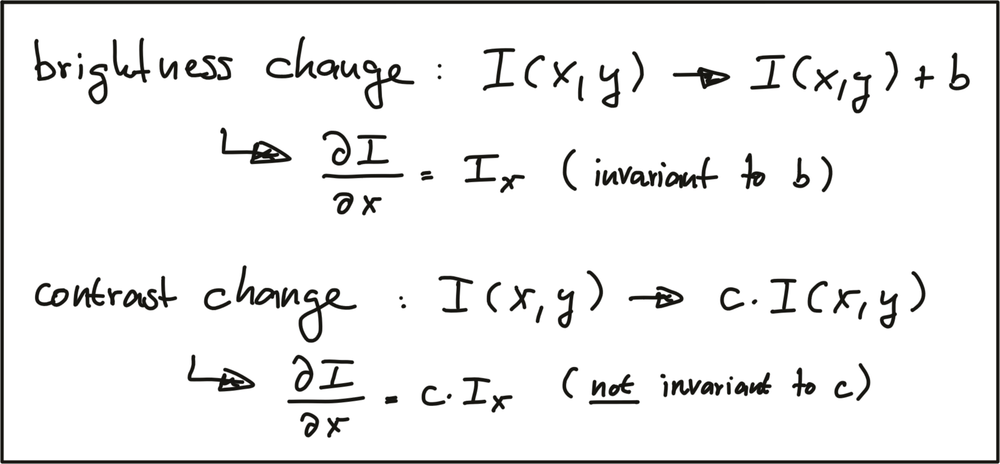

Scale change:

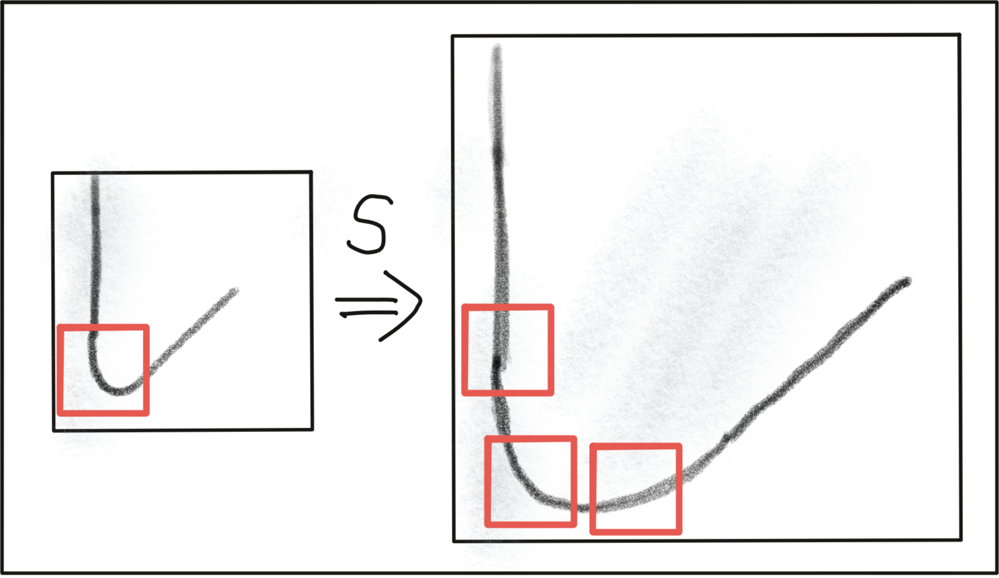

Summarizing, the Harris detector is robust under **rotation** and **additive intensity shifts**, but sensitive to **scale** change, **multiplicative intensity shifts** (i.e. changes in **contrast**) and **affine transformations**. However, if it were possible to modify the Harris detector in a way such that it were able to account for changes of the object scale, e.g. when the preceding vehicle approaches, it might be (despite its age), a suitable detector for our purposes.

### b) Automatic Scale Selection
In order to detect keypoints at their ideal scale, we must know (or find) their respective dimensions in the image and adapt the size of the Gaussian window w(x,y) as introduced earlier in this section. If the keypoint scale is unknown or if keypoints with varying size exist in the image, detection must be performed successively at multiple scale levels.

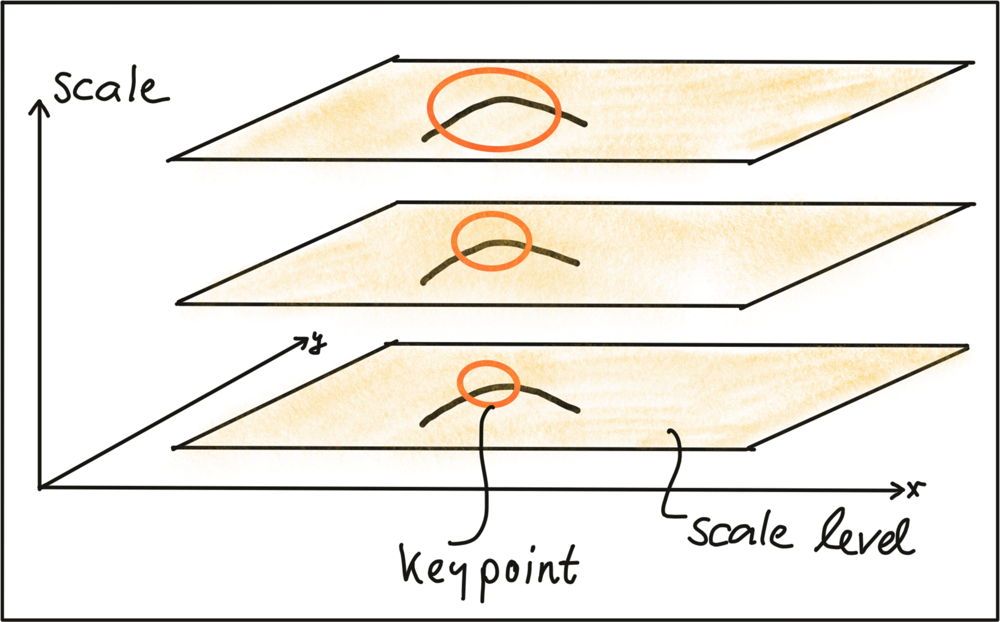

Based on the increment of the standard deviation between two neighboring levels, the same keypoint might be detected multiple times. This poses the problem of choosing the „correct“ scale which best represents the keypoint.

In a landmark paper from 1998, Tony Lindeberg published a method for "Feature detection with automatic scale selection". In this paper, he proposed a function F(x,y,scale), which could be used to select those keypoints that showed a stable maximum of F over scale. The scale for which F was maximized was termed the "characteristic scale“ of the respective keypoint.

The following image shows such a function F which has been evaluated for several scale levels and exhibits a clear maximum that can be seen as the characteristic scale of the image content within the circular region.

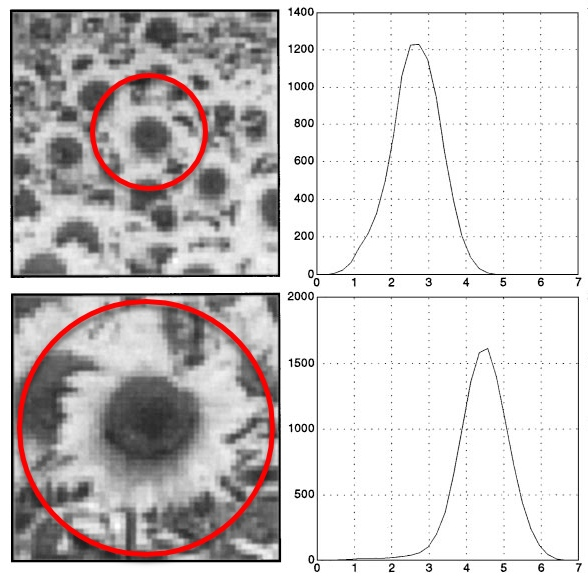
Adapted from Feature Detection with Automatic Scale Selection.

Details of how to properly design a suitable function FF are not in the focus of this course however. The major take-away is the knowledge that a good detector is able to automatically select the characteristic scale of a keypoint based on structural properties of its local neighborhood. Modern keypoint detectors usually possess this ability and are thus robust under changes of the image scale.

### c) Overview of Popular Keypoint Detectors
Keypoint detectors are a very popular research area and thus a large number of powerful algorithms have been developed over the years. Applications of keypoint detection include such things as object recognition and tracking, image matching and panoramic stitching as well as robotic mapping and 3D modeling. In addition to invariance under the transformations mentioned above, detectors can be compared for their detection performance and their processing speed.

The Harris detector along with several other "classics" belongs to a group of traditional detectors, which aim at maximizing detection accuracy. In this group, computational complexity is not a primary concern. The following list shows a number of popular classic detectors :

* 1988 Harris Corner Detector (Harris, Stephens)
* 1996 Good Features to Track (Shi, Tomasi)
* 1999 Scale Invariant Feature Transform (Lowe)
* 2006 Speeded Up Robust Features (Bay, Tuytelaars, Van Gool)

In recent years, a number of faster detectors has been developed which aims at real-time applications on smartphones and other portable devices. The following list shows the most popular detectors belonging to this group:

* 2006 Features from Accelerated Segment Test (FAST) (Rosten, Drummond)
* 2010 Binary Robust Independent Elementary Features (BRIEF) (Calonder, et al.)
* 2011 Oriented FAST and Rotated BRIEF (ORB) (Rublee et al.)
* 2011 Binary Robust Invariant Scalable Keypoints (BRISK) (Leutenegger, Chli, Siegwart)
* 2012 Fast Retina Keypoint (FREAK) (Alahi, Ortiz, Vandergheynst)
* 2012 KAZE (Alcantarilla, Bartoli, Davidson)

In this course, we will be using the **Harris** detector as well as the **Shi-Tomasi** detector (which is very similar to Harris) as representatives from the first group of "classic“ detectors. From the second group, we will be leveraging the OpenCV to implement the entire list of detectors.

### d) Exercise
Before we go into details on the above-mentioned detectors in the next section, use the OpenCV library to add the FAST detector in addition to the already implemented Shi-Tomasi detector and compare both algorithms with regard to (a) number of keypoints, (b) distribution of keypoints over the image and (c) processing speed. Describe your observations with a special focus on the preceding vehicle.

```c++
// load image from file and convert to grayscale
cv::Mat imgGray;
cv::Mat img = cv::imread("../images/img1.png");
cv::cvtColor(img, imgGray, cv::COLOR_BGR2GRAY);

// Shi-Tomasi detector
int blockSize = 6;       //  size of a block for computing a derivative covariation matrix over each pixel neighborhood
double maxOverlap = 0.0; // max. permissible overlap between two features in %
double minDistance = (1.0 - maxOverlap) * blockSize;
int maxCorners = img.rows * img.cols / max(1.0, minDistance); // max. num. of keypoints
double qualityLevel = 0.01;                                   // minimal accepted quality of image corners
double k = 0.04;
bool useHarris = false;

vector<cv::KeyPoint> kptsShiTomasi;
vector<cv::Point2f> corners;
double t = (double)cv::getTickCount();
cv::goodFeaturesToTrack(imgGray, corners, maxCorners, qualityLevel, minDistance, cv::Mat(), blockSize, useHarris, k);
t = ((double)cv::getTickCount() - t) / cv::getTickFrequency();
cout << "Shi-Tomasi with n= " << corners.size() << " keypoints in " << 1000 * t / 1.0 << " ms" << endl;

for (auto it = corners.begin(); it != corners.end(); ++it)
{ // add corners to result vector

    cv::KeyPoint newKeyPoint;
    newKeyPoint.pt = cv::Point2f((*it).x, (*it).y);
    newKeyPoint.size = blockSize;
    kptsShiTomasi.push_back(newKeyPoint);
}

// visualize results
cv::Mat visImage = img.clone();
cv::drawKeypoints(img, kptsShiTomasi, visImage, cv::Scalar::all(-1), cv::DrawMatchesFlags::DRAW_RICH_KEYPOINTS);
string windowName = "Shi-Tomasi Results";
cv::namedWindow(windowName, 1);
imshow(windowName, visImage);

// STUDENT CODE
int threshold = 30;                                                              // difference between intensity of the central pixel and pixels of a circle around this pixel
bool bNMS = true;                                                                // perform non-maxima suppression on keypoints
cv::FastFeatureDetector::DetectorType type = cv::FastFeatureDetector::TYPE_9_16; // TYPE_9_16, TYPE_7_12, TYPE_5_8
cv::Ptr<cv::FeatureDetector> detector = cv::FastFeatureDetector::create(threshold, bNMS, type);

vector<cv::KeyPoint> kptsFAST;
t = (double)cv::getTickCount();
detector->detect(imgGray, kptsFAST);
t = ((double)cv::getTickCount() - t) / cv::getTickFrequency();
cout << "FAST with n= " << kptsFAST.size() << " keypoints in " << 1000 * t / 1.0 << " ms" << endl;

visImage = img.clone();
cv::drawKeypoints(img, kptsFAST, visImage, cv::Scalar::all(-1), cv::DrawMatchesFlags::DRAW_RICH_KEYPOINTS);
windowName = "FAST Results";
cv::namedWindow(windowName, 2);
imshow(windowName, visImage);
cv::waitKey(0);

// EOF STUDENT CODE

```


## 4. Gradient-based vs. Binary Descriptors

> Project code in `describe_keypoionts` folder

### a) Detectors and Descriptors
Before we go into details on how some of the keypoint detectors discussed in the previous section work, let us take a look at the problem ahead of us. Our task is to find corresponding keypoints in a sequence of images that we can use to compute the TTC to a preceding object, e.g. a vehicle. We therefore need a way to robustly assign keypoints to each other based on some measure of similarity. In the literature, a large variety of ***similarity measures*** (called ***descriptors***) have been proposed and in many cases, authors have published both a new method for keypoint detection as well as similarity measure which has been optimized for their type of keypoints.

Let us refine our terminology at this point :

* A ***keypoint*** (sometimes also interest point or salient point) detector is an algorithm that chooses points from an image based on a local maximum of a function, such as the "cornerness" metric we saw with the Harris detector.
* A ***descriptor*** is a vector of values, which describes the image patch around a keypoint. There are various techniques ranging from comparing raw pixel values to much more sophisticated approaches such as histograms of gradient orientations.

Descriptors help us to assign similar keypoints in different images to each other. As shown in the figure below, a set of keypoints in one frame is assigned keypoints in another frame such that the similarity of their respective descriptors is maximized and (ideally) the keypoints represent the same object in the image. In addition to maximizing similarity, a good descriptor should also be able to minimize the number of mismatches, i.e. avoid assigning keypoints to each other that do not correspond to the same object.

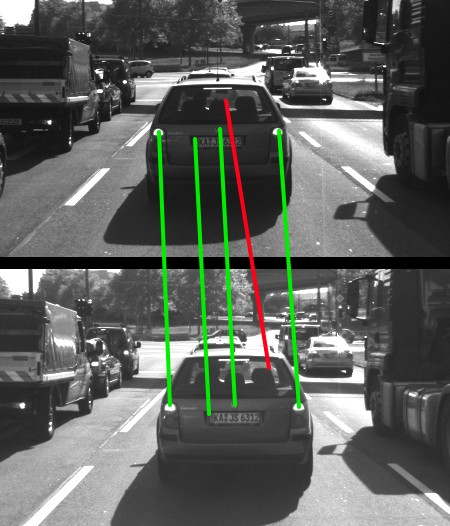

Before we go into details on a powerful class of detector / descriptor combinations (i.e. binary descriptors such as BRISK), let us briefly revisit one of the most famous descriptors of all time - the Scale Invariant Feature Transform. The reason we are doing this is two-fold : First, this method is still relevant and being used in a large number of applications. And second, we need to lay some foundations so that you will be able to better understand and appreciate the contributions of binary descriptors.

### b) HOG Descriptors and SIFT
In the following, we will take a brief look at the family of descriptors based on **Histograms of Oriented Gradients** (HOG). The basic idea behind HOG is to describe the structure of an object by the distribution its intensity gradients in a local neighborhood. To achieve this, an image is divided into cells in which gradients are computed and collected in a histogram. The set of histogram from all cells is then used as a similarity measure to uniquely identify an image patch or object.

One of the best-known examples of the HOG family is the **Scale-Invariant Feature Transform (SIFT)**, introduced in 1999 by David Lowe. The SIFT method includes both a keypoint detector as well as a descriptor and it follows a five-step process, which is briefly outlined in the following.

1. First, keypoints are detected in the image using an approach called "**Laplacian-Of-Gaussian (LoG)**“, which is based on **second-degree intensity derivatives**. The LoG is applied to various scale levels of the image and tends to detect blobs instead of corners. In addition to a **unique scale level**, keypoints are also assigned an **orientation** based on the intensity gradients in a local neighborhood around the keypoint.
2. Second, for every keypoint, its surrounding area is transformed by removing the orientation and thus ensuring a ***canonical orientation***. Also, the size of the area is resized to **16 x 16** pixels, providing a normalized patch.

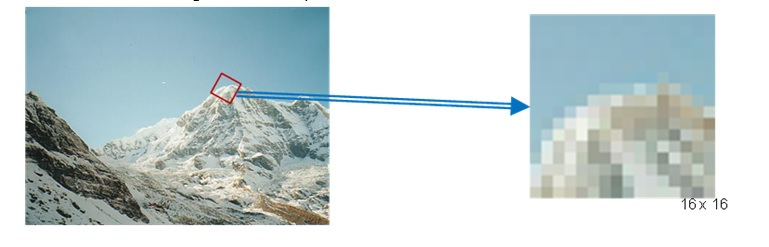
The mountain scenery image material has been taken from the original publication by D. Lowe.

3. Third, the **orientation** and **magnitude** of each pixel within the normalized patch are computed based on the intensity gradients Ix and Iy.
4. Fourth, the normalized patch is divided into a grid of **4 x 4** cells. Within each cell, the orientations of pixels which exceed a threshold on magnitude are collected in a histogram consisting of **8 bins**.

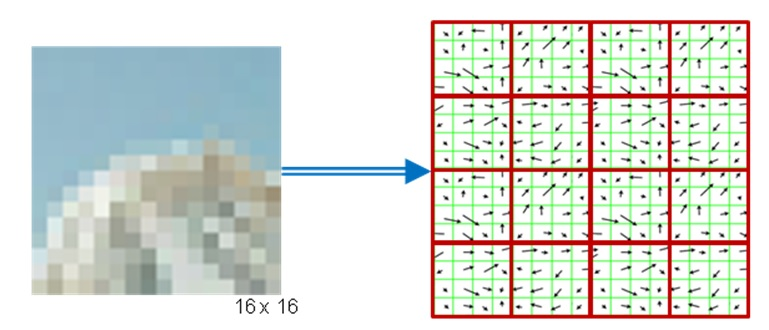
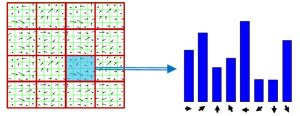

5. Last, the 8-bin histograms of all 16 cells are concatenated into a **128-dimensional vector** (the descriptor) which is used to uniquely represent the keypoint.

The SIFT detector / descriptor is able to robustly identify objects even among **clutter** and under **partial occlusion**. It is invariant to uniform changes in **scale**, to **rotation**, to changes in both **brightness** and **contrast** and it is even **partially invariant to affine distortions**.

The downside of SIFT is its **low speed**, which prevents it from being used in real-time applications on e.g. smartphones. Other members of the HOG family (such as **SURF** and **GLOH**), have been optimized for speed. However, they are still too computationally expensive and should not be used in real-time applications. Also, SIFT and SURF are heavily patented, so they can’t be freely used in a commercial context. In order to use SIFT in the OpenCV, you have to `#include <opencv2/xfeatures2d/nonfree.hpp>`, which further emphasizes this issue.

A much faster (and free) alternative to HOG-based methods is the family of binary descriptors, which provide a fast alternative at only slightly worse accuracy and performance. Let us take a look at those in the next section.

### c) Binary Descriptors and BRISK
The problem with HOG-based descriptors is that they are based on computing the **intensity gradients**, which is a very costly operation. Even though there have been some improvements such as **SURF**, which uses the integral image instead, these methods do not lend themselves to real-time applications on devices with limited processing capabilities (such as smartphones).

The central idea of binary descriptors is to rely solely on the intensity information (i.e. the image itself) and to encode the information around a keypoint in a string of binary numbers, which can be compared very efficiently in the matching step, when corresponding keypoints are searched. Currently, the most popular binary descriptors are **BRIEF, BRISK, ORB, FREAK and KAZE** (all available in the OpenCV library).

From a high-level perspective, binary descriptors consist of three major parts:
1. A **sampling pattern** which describes where sample points are located around the location of a keypoint.
2. A method for **orientation compensation**, which removes the influence of rotation of the image patch around a keypoint location.
3. A method for **sample-pair selection**, which generates pairs of sample points which are compared against each other with regard to their intensity values. If the first value is larger than the second, we write a '1' into the binary string, otherwise we write a '0'. After performing this for all point pairs in the sampling pattern, a long binary chain (or ‚string‘) is created (hence the family name of this descriptor class).

In the following, the "***Binary Robust Invariant Scalable Keypoints (BRISK)***" keypoint detector / descriptor is used as a representative for the binary descriptor family. Proposed in 2011 by Stefan Leutenegger et al., BRISK is a **FAST-based** detector in combination with a binary descriptor created from intensity comparisons retrieved by dedicated sampling of each keypoint neighborhood.

The **sampling pattern** of BRISK is composed out of a number of sample points (blue), where a concentric ring (red) around each sample point denotes an area where Gaussian smoothing is applied. As opposed to some other binary descriptors such as **ORB** or **BRIEF**, the BRISK sampling pattern is **fixed**. The smoothing is important to avoid aliasing (an effect that causes different signals to become indistinguishable - or aliases of one another - when sampled).

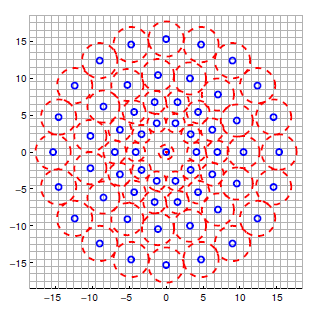

During sample pair selection, the BRISK algorithm differentiates between long- and short-distance pairs. The long-distance pairs (i.e. sample points with a minimal distance between each other on the sample pattern) are used for estimating the orientation of the image patch from intensity gradients, whereas the short-distance pairs are used for the intensity comparisons from which the descriptor string is assembled. Mathematically, the pairs are expressed as follows:

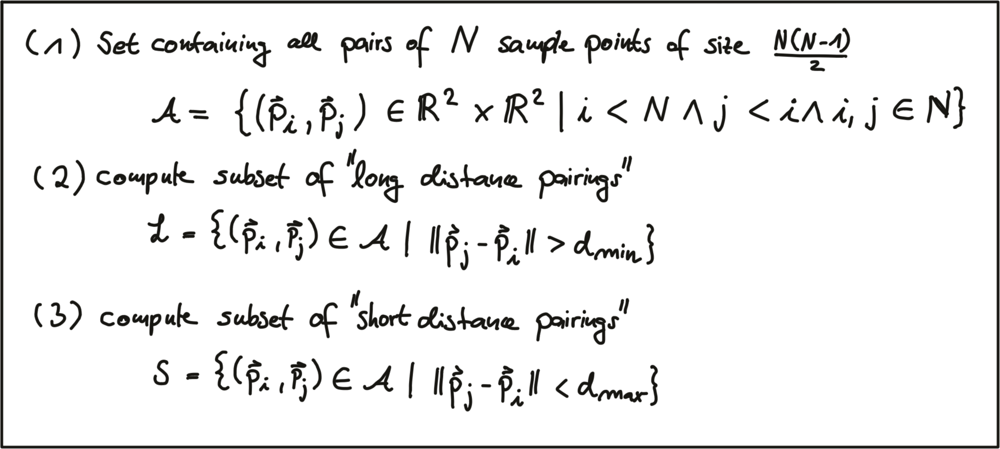

First, we define the set A of all possible pairings of sample points. Then, we extract the subset L from A for which the euclidean distance is above a pre-defined upper threshold. This set are the long-distance pairs used for orientation estimation. Lastly, we extract those pairs from A whose euclidean distance is below a lower threshold. This set S contains the short-distance pairs for assembling the binary descriptor string.

The following figure shows the two types of distance pairs on the sampling pattern for short pairs (left) and long pairs (right).

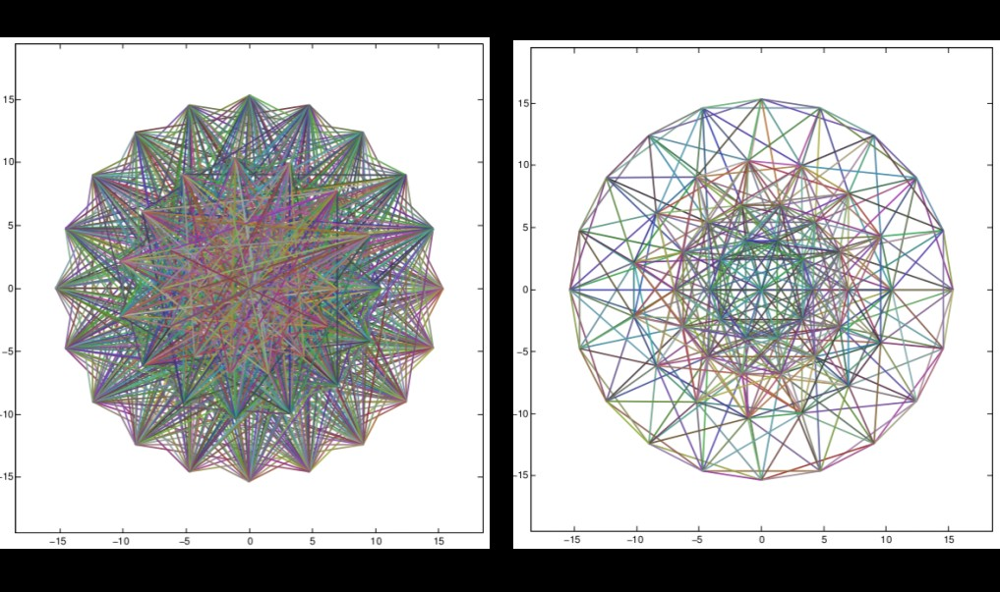

From the long pairs, the keypoint direction vector g⃗ is computed as follows:

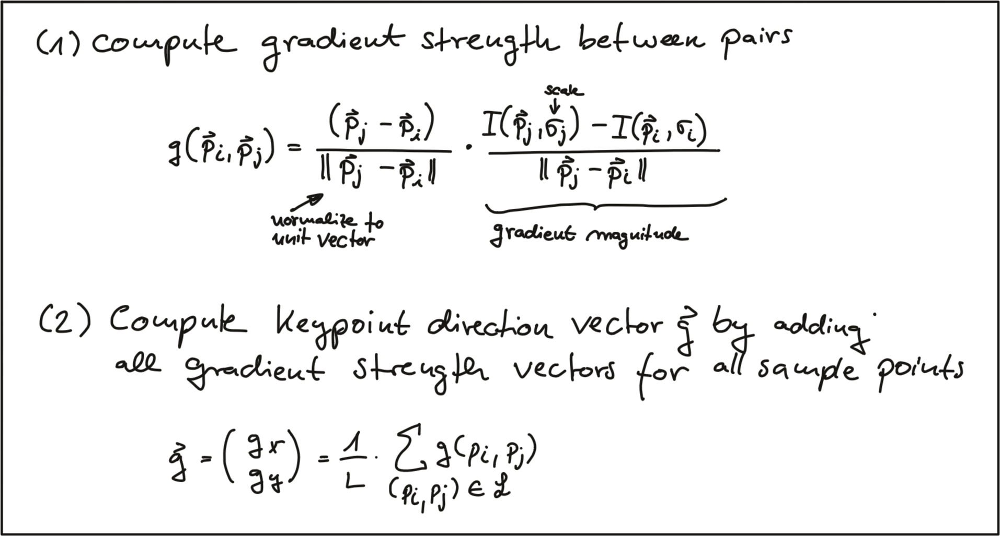

First, the gradient strength between two sample points is computed based on the normalized unit vector that gives the direction between both points multiplied with the intensity difference of both points at their respective scales. In (2), the keypoint direction vector g⃗ is then computed from the sum of all gradient strengths.

Based on g⃗, we can use the direction of the sample pattern to rearrange the short-distance pairings and thus ensure rotation invariance. Based on the rotation-invariant short-distance pairings, the final binary descriptor can be constructed as follows:

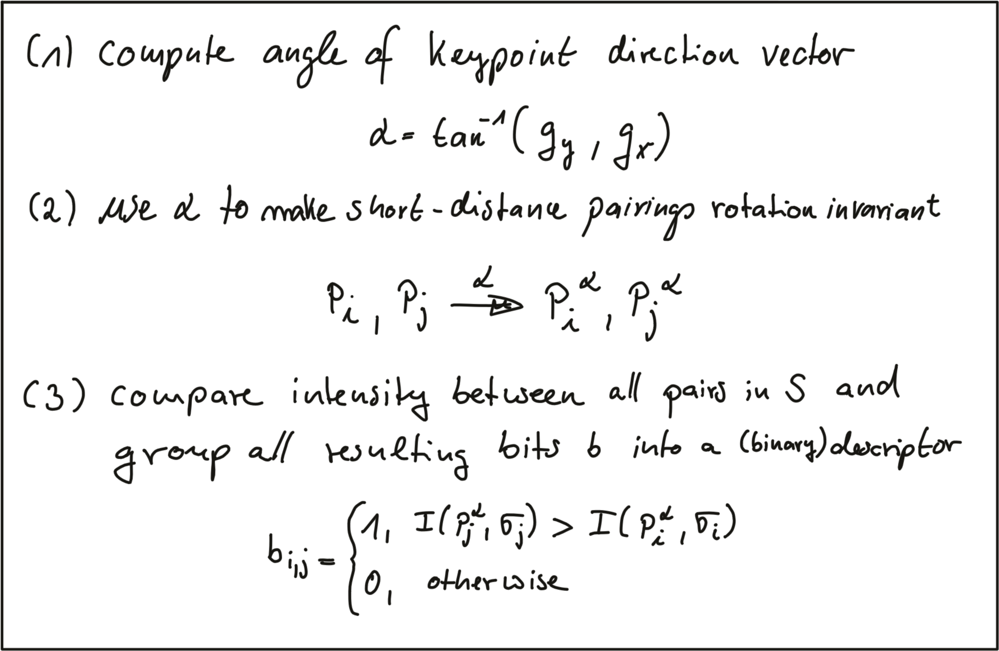

After computing the orientation angle of the keypoint from g, we use it to make the short-distance pairings invariant to rotation. Then, the intensity between all pairs in SS is compared and used to assemble the binary descriptor we can use for matching.

### d) HOG vs. Binary Exercise

In the code at the end of this section, keypoints and descriptors are computed using the BRISK method. The time for both keypoint detection and descriptor computation is printed to the console. For the BRISK detector, the keypoints can be seen in the following figure with the center of a circle denoting its location and the size of the circle reflecting the characteristic scale.

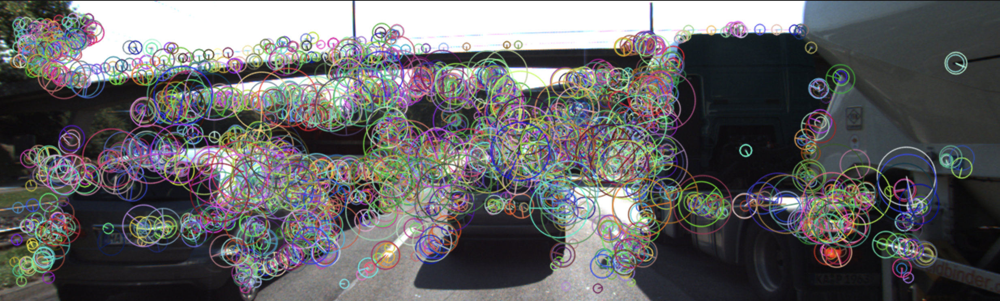

Given the code in `describe_keypoints.cpp` of the workspace below, add the SIFT detector / descriptor, compute the time for both steps and compare both BRISK and SIFT with regard to processing speed and the number and visual appearance of keypoints.

After building your code with `cmake` and `make`, you can run the code from the virtual desktop using the `describe_keypoints` executable.

In the next section, we will look at the descriptor part of BRISK in detail.

```c++
void descKeypoints1()
{
    // load image from file and convert to grayscale
    cv::Mat imgGray;
    cv::Mat img = cv::imread("../images/img1.png");
    cv::cvtColor(img, imgGray, cv::COLOR_BGR2GRAY);

    // BRISK detector / descriptor
    cv::Ptr<cv::FeatureDetector> detector = cv::BRISK::create();
    vector<cv::KeyPoint> kptsBRISK;

    double t = (double)cv::getTickCount();
    detector->detect(imgGray, kptsBRISK);
    t = ((double)cv::getTickCount() - t) / cv::getTickFrequency();
    cout << "BRISK detector with n= " << kptsBRISK.size() << " keypoints in " << 1000 * t / 1.0 << " ms" << endl;

    cv::Ptr<cv::DescriptorExtractor> descriptor = cv::BRISK::create();
    cv::Mat descBRISK;
    t = (double)cv::getTickCount();
    descriptor->compute(imgGray, kptsBRISK, descBRISK);
    t = ((double)cv::getTickCount() - t) / cv::getTickFrequency();
    cout << "BRISK descriptor in " << 1000 * t / 1.0 << " ms" << endl;

    // visualize results
    cv::Mat visImage = img.clone();
    cv::drawKeypoints(img, kptsBRISK, visImage, cv::Scalar::all(-1), cv::DrawMatchesFlags::DRAW_RICH_KEYPOINTS);
    string windowName = "BRISK Results";
    cv::namedWindow(windowName, 1);
    imshow(windowName, visImage);

    // TODO: Add the SIFT detector / descriptor, compute the 
    // time for both steps and compare both BRISK and SIFT
    // with regard to processing speed and the number and 
    // visual appearance of keypoints.
    // BRISK detector / descriptor
    cv::Ptr<cv::FeatureDetector> detectorSIFT = cv::xfeatures2d::SIFT::create();
    vector<cv::KeyPoint> kptsSIFT;

    t = (double)cv::getTickCount();
    detector->detect(imgGray, kptsSIFT);
    t = ((double)cv::getTickCount() - t) / cv::getTickFrequency();
    cout << "SIFT detector with n= " << kptsSIFT.size() << " keypoints in " << 1000 * t / 1.0 << " ms" << endl;

    cv::Ptr<cv::DescriptorExtractor> descriptor_SIFT = cv::xfeatures2d::SIFT::create();
    cv::Mat descSIFT;
    t = (double)cv::getTickCount();
    descriptor->compute(imgGray, kptsSIFT, descSIFT);
    t = ((double)cv::getTickCount() - t) / cv::getTickFrequency();
    cout << "SIFT descriptor in " << 1000 * t / 1.0 << " ms" << endl;

    // visualize results
    visImage = img.clone();
    cv::drawKeypoints(img, kptsSIFT, visImage, cv::Scalar::all(-1), cv::DrawMatchesFlags::DRAW_RICH_KEYPOINTS);
    windowName = "SIFT Results";
    cv::namedWindow(windowName, 1);
    imshow(windowName, visImage);
    cv::waitKey(0);
}

```


## 5. Descriptor Matching

> Project code in `describe_matching` folder

### a) Distance between descriptors
In the last section, you have learned that keypoints can be described by transforming their local neighborhood into a high-dimensional vector that captures the unique characteristics of the gradient or intensity distribution. In this section, we want to look at several ways to compute the distance between two descriptors such that the differences between them are transformed into a single number which we can use as a simple measure of similarity.

The first distance function is the "***Sum of Absolute Differences (SAD)***". As you can see in the equation below, the SAD takes as input two descriptor vectors d_a and d_b. The SAD is computed by subtracting from every component in d_a the corresponding component at the same position in d_b. Then, the absolute value of the respective result is summed up. The SAD norm is also referred to as **L1-norm** in the literature.

The second distance function is the "***Sum of Squared Differences (SSD)***", which is similar to the SAD in the sense that differences between individual components of two descriptor vectors are computed. However, the key difference between SAD and SSD is that the latter sums the squared differences instead of the absolute differences. In the literature, the SSD norm is also referred to as **L2-norm**. Both norms are given in the following figure.

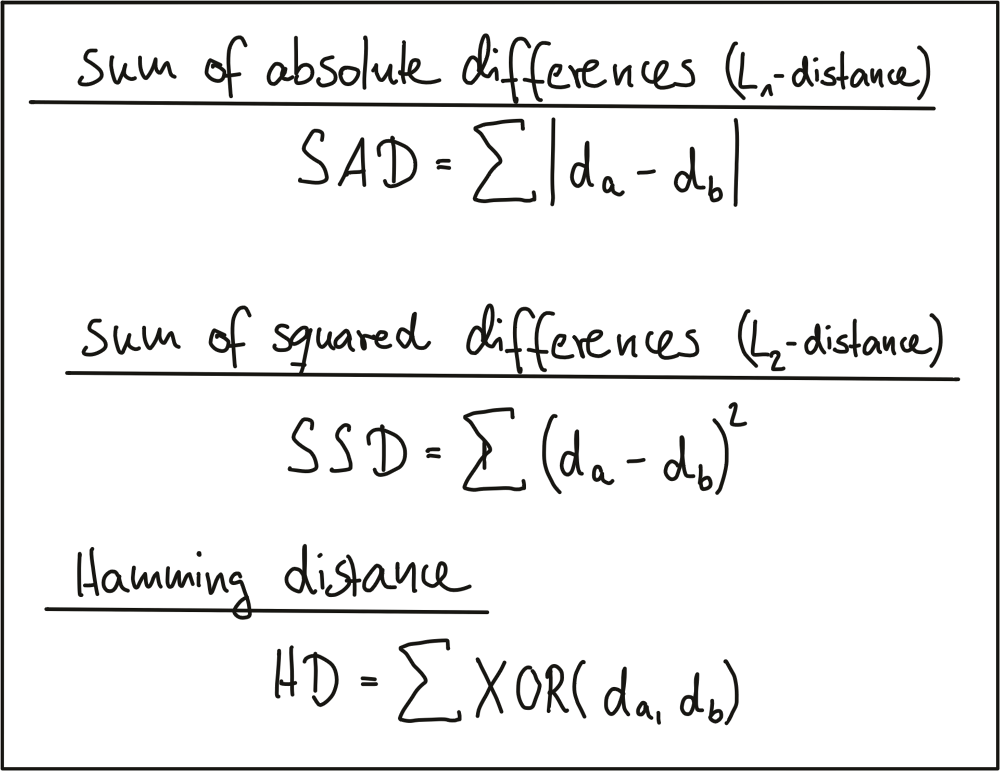

There are several ways of explaining the differences between SAD and SSD. One helpful approach, as we want to keep this aspect short, is to look at both norms from a geometrical perspective. In the following figure, a two-dimensional feature space is considered. In it, there are two feature vectors d1 and d2, each of which consists of an (a,b) coordinate pair.

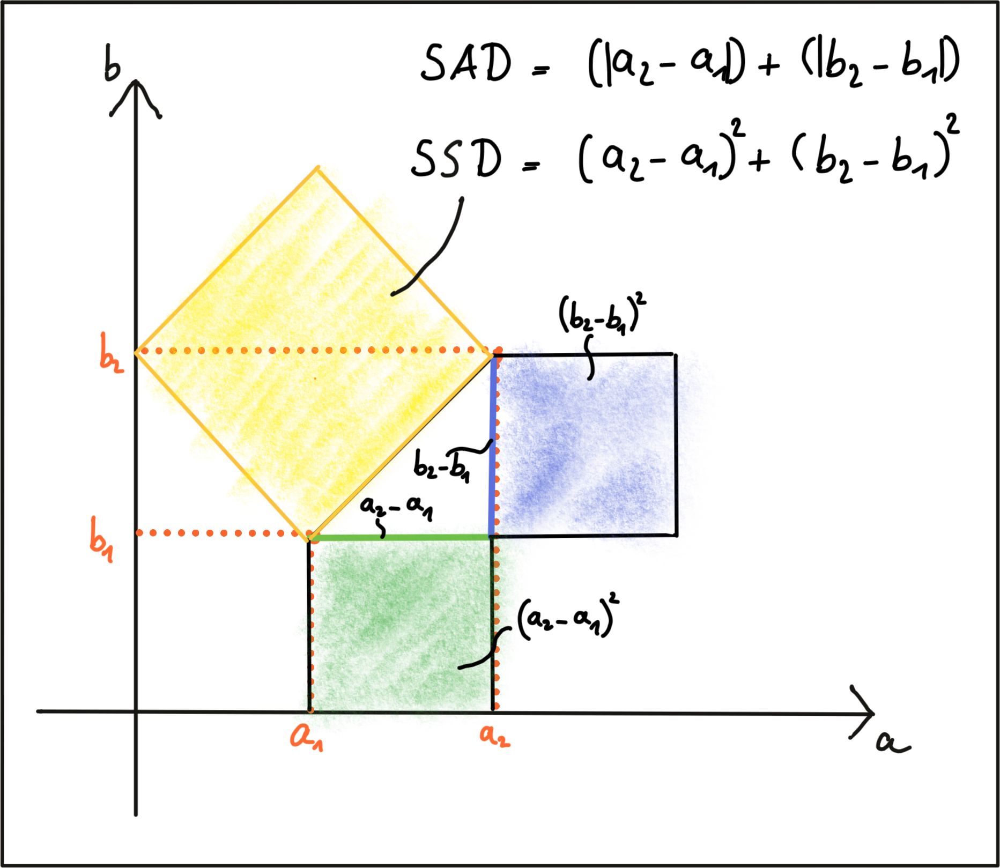

The shortest distance between both is a straight line. Given the two components of each vector, the SAD computes the sum of the length differences, which is a one-dimensional process. The SSD on the other hand, computes the sum of squares, which obeys the law of Pythagoras. This law says that In a rectangular triangle, the sum of the cathete squares is equal to the square of the hypotenuse. So in terms of the geometric distance between both vectors, the L2-norm is a more accurate measure. Note that the same rationale applies to **higher-dimensional descriptors** in the same manner.

In the case of a binary descriptor who consists only of ones and zeros, the best (and fastest) measure to use is the ***Hamming distance***, which computes the difference between both vectors by using an **XOR** function, which returns zero if two bits are identical and one if two bits are different. So the sum of all XOR operations is simply the number of differing bits between both descriptors.

The key takeaway here is that you have to adapt the **distance measure** to the **type of descriptor** you are using. In case of gradient-based methods such as SIFT, the **L2-norm** would be most appropriate. In case of all binary descriptors, the **Hamming distance** should be used.

### b) Finding matches
Let us assume we have N keypoints and their associated descriptors in one image and M keypoints in another image. The most obvious method to look for corresponding pairs would be to compare all features with each other, i.e. perform N x M comparisons. For a given keypoint from the first image, it takes every keypoint in the second image and calculates the distance. The keypoint with the **smallest distance** will be considered its pair. This approach is referred to as **Brute Force Matching** or **Nearest Neighbor Matching** and is available in the OpenCV under the name `BFMatcher`. The output of brute force matching in OpenCV is a list of keypoint pairs sorted by the distance of their descriptors under the chosen distance function. Brute force matching works well for small keypoint numbers but can be computationally expensive as the number of keypoints increases.

In 2014, David Lowe (the father of SIFT) and Marius Muja released an open-source library called "**fast library for approximate nearest neighbors**" (FLANN). FLANN trains an indexing structure for walking through potential matching candidates that is created using concepts from machine learning. The library builds a very efficient data structure (a KD-tree) to search for matching pairs and avoids the exhaustive search of the brute force approach. It is therefore faster while the results are still very good, depending on the matching parameters. As FLANN-based matching entails a whole new body of knowledge with several concepts that have limited relevancy for this course, there is no detailed description of the method given here. The FLANN-based matching is available in the OpenCV and you will see it again in the code example below. At the time of writing (May 2019), there is a potential bug in the current implementation of the OpenCV, which requires a conversion of the binary descriptors into floating point vectors, which is inefficient. Yet still there is an improvement in speed, albeit not as large as it potentially could be.

Both BFMatching and FLANN accept a descriptor distance threshold T which is used to limit the number of matches to the ‚good‘ ones and discard matches where the respective pairs are no correspondences. Corresponding ‚good‘ pairs are termed ‚True Positives (TP)‘ whereas mismatches are called ‚False Positives (FP)‘. The task of selecting a suitable value for T is to allow for as many TP matches as possible while FP matches should be avoided as far as possible. Depending on the image content and on the respective detector / descriptor combination, a trade-off between TP and FP has to be found that reasonably balances the ratio between TP and FP. The following figure shows two distributions of TP and of FP over the SSD to illustrate threshold selection.

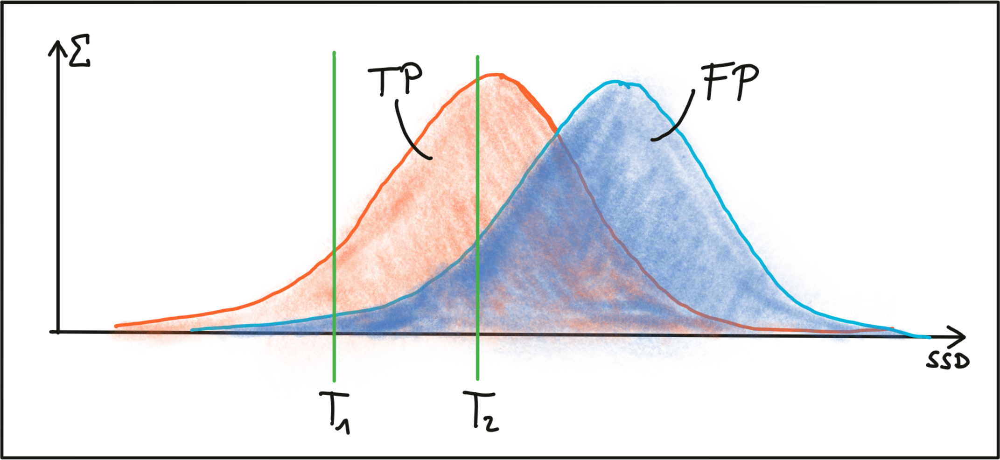

The first threshold T1 is set to a maximally permissible SSD between two features in a way that some true positive matches are selected, while false positive matches are almost entirely avoided . However, most TP matches are also discarded with this setting. By increasing the matching threshold to T2, more TP matches are selected but the number of FP matches also increases significantly. In practice, a clear and concise separation of TP and FP is almost never found and therefore, setting a matching threshold is always a compromise between balancing 'good' vs. 'bad' matches. While FP matches can not be avoided in most cases, the goal always is to lower their number as much as possible. In the following, two strategies to achieve this are presented.

### c) Selecting Matches
As long as the selected threshold T is not exceeded, brute force matching will always return a match for a keypoint in the first image, even if the keypoint is not present in the second image. This inevitably leads to a number of false matches. A strategy to counteract this is called **cross check matching**, which works by applying the matching procedure in both directions and keeping only those matches whose best match in one direction equals the best match in the other direction. The steps of the cross check approach are:

1. For each descriptor in the source image, find one or more best matches in the reference image.
2. Switch the order of source and reference image.
3. Repeat the matching procedure between source and reference image from step 1.
4. Select those keypoint pairs whose descriptors are best matches in both directions.

Although cross check matching increases the processing time, it usually removes a significant number of false matches and should thus always be performed when **accuracy** is preferred over speed.

A very efficient way of lowering the number of false positives is to compute the ***nearest neighbor distance ratio*** for each keypoint. This method has been originally proposed by D. Lowe in the 1999 paper on SIFT. The main idea is to not apply the threshold on the SSD directly. Instead, for each keypoint in the source image, the **two best matches** are located in the reference image and the ratio between the descriptor distances is computed. Then, a threshold is applied to the ratio to sort out ambiguous matches. The figure below illustrates the principle.

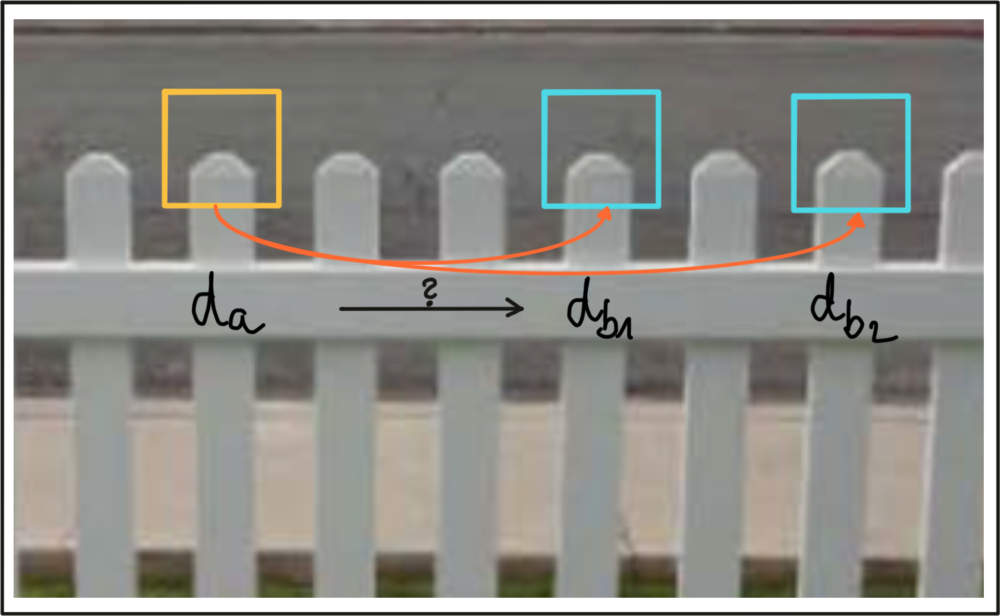

In the example, an image patch with an associated descriptor da is compared to two other image patches with descriptors d_{b_1} and d_{b_2}. As can be seen, the patches look very similar and would result in ambiguous and thus unreliable matches. By computing the **SSD ratio between best and second-best match**, such weak candidates can be filtered out.

In practice, a threshold value of **0.8** has proven to provide a good balance between TP and FP. In the image sequences examined in the original SIFT paper, 90% of the false matches were eliminated with this setting while less than 5% of correct matches were lost.

### d) Exercise: Distance between descriptors
In the following code example, a set of binary BRISK descriptors is pre-loaded and matched using the brute force approach described earlier in this section. Note that the number of matches has been limited to the 100 best candidates for educational purposes, as it is much easier to visually spot mismatches when drawing a reduced number of keypoint pairs as an overlay. Note that once the matches have been computed, the function can be set to either nearest-neighbor (keeping only the best match) or k-nearest-neighbor selection (keeping the best k matches per keypoint).

Before we take a look at how to estimate the performance of keypoints and descriptors further down below in this section, please complete the following tasks using the desktop workspace below:

1. Load the 'BRISK_small' dataset with cross-check first turned off, then on. Look at the visualized keypoint matches and at the number of matched pairs and describe your results.
2. Add the k-nearest-neighbor matching (using `cv::knnMatch`) with k=2 and implement the above-described descriptor distance ratio to filter out ambiguous matches with the threshold set to 0.8. Visualize the results, count the percentage of discarded matches (for both the 'BRISK_small' and the 'BRISK_large' dataset) and describe your observations.
3. Use both BF matching and FLANN matching on the 'BRISK_large' dataset and on the SIFT dataset and describe your observations.

The code for this exercise is in the `descriptor_matching.cpp` file, and after building with `cmake` and `make`, you can run the code using the `descriptor_matching` executable.

```c++
#include <iostream>
#include <numeric>
#include <opencv2/core.hpp>
#include <opencv2/highgui.hpp>
#include <opencv2/imgproc.hpp>
#include <opencv2/features2d.hpp>

#include "structIO.hpp"

using namespace std;

void matchDescriptors(cv::Mat &imgSource, cv::Mat &imgRef, vector<cv::KeyPoint> &kPtsSource, vector<cv::KeyPoint> &kPtsRef, cv::Mat &descSource, cv::Mat &descRef,
                      vector<cv::DMatch> &matches, string descriptorType, string matcherType, string selectorType)
{

    // configure matcher
    bool crossCheck = true;
    cv::Ptr<cv::DescriptorMatcher> matcher;

    if (matcherType.compare("MAT_BF") == 0)
    {

        int normType = descriptorType.compare("DES_BINARY") == 0 ? cv::NORM_HAMMING : cv::NORM_L2;
        matcher = cv::BFMatcher::create(normType, crossCheck);
        cout << "BF matching cross-check=" << crossCheck;
    }
    else if (matcherType.compare("MAT_FLANN") == 0)
    {
        if (descSource.type() != CV_32F)
        { // OpenCV bug workaround : convert binary descriptors to floating point due to a bug in current OpenCV implementation
            descSource.convertTo(descSource, CV_32F);
            descRef.convertTo(descRef, CV_32F);
        }

        //... TODO : implement FLANN matching
        // matcher = cv::DescriptorMatcher::create(cv::DescriptorMatcher::FLANNBASED);
        matcher = cv::FlannBasedMatcher::create();
        cout << "FLANN matching";
    }

    // perform matching task
    if (selectorType.compare("SEL_NN") == 0)
    { // nearest neighbor (best match)

        double t = (double)cv::getTickCount();
        matcher->match(descSource, descRef, matches); // Finds the best match for each descriptor in desc1
        t = ((double)cv::getTickCount() - t) / cv::getTickFrequency();
        cout << " (NN) with n=" << matches.size() << " matches in " << 1000 * t / 1.0 << " ms" << endl;
    }
    else if (selectorType.compare("SEL_KNN") == 0)
    { // k nearest neighbors (k=2)

        // TODO : implement k-nearest-neighbor matching
        vector<vector<cv::DMatch>> knn_matches;
        double t = (double)cv::getTickCount();
        matcher->knnMatch(descSource, descRef, knn_matches, 2); // finds the 2 best matches
        t = ((double)cv::getTickCount() - t) / cv::getTickFrequency();
        cout << " (KNN) with n=" << knn_matches.size() << " matches in " << 1000 * t / 1.0 << " ms" << endl;

        // STUDENT TASK
        // filter matches using descriptor distance ratio test
        double minDescDistRatio = 0.8;
        for (auto it = knn_matches.begin(); it != knn_matches.end(); ++it)
        {

            if ((*it)[0].distance < minDescDistRatio * (*it)[1].distance)
            {
                matches.push_back((*it)[0]);
            }
        }
        cout << "# keypoints removed = " << knn_matches.size() - matches.size() << endl;
    }

    // visualize results
    cv::Mat matchImg = imgRef.clone();
    cv::drawMatches(imgSource, kPtsSource, imgRef, kPtsRef, matches,
                    matchImg, cv::Scalar::all(-1), cv::Scalar::all(-1), vector<char>(), cv::DrawMatchesFlags::DRAW_RICH_KEYPOINTS);

    string windowName = "Matching keypoints between two camera images (best 50)";
    cv::namedWindow(windowName, 7);
    cv::imshow(windowName, matchImg);
    cv::waitKey(0);
}

int main()
{
    cv::Mat imgSource = cv::imread("../images/img1gray.png");
    cv::Mat imgRef = cv::imread("../images/img2gray.png");

    vector<cv::KeyPoint> kptsSource, kptsRef; 
    readKeypoints("../dat/C35A5_KptsSource_SIFT.dat", kptsSource);
    readKeypoints("../dat/C35A5_KptsRef_SIFT.dat", kptsRef);

    cv::Mat descSource, descRef; 
    readDescriptors("../dat/C35A5_DescSource_SIFT.dat", descSource);
    readDescriptors("../dat/C35A5_DescRef_SIFT.dat", descRef);

    vector<cv::DMatch> matches;
    string matcherType = "MAT_FLANN"; // MAT_BF, MAT_FLANN
    string descriptorType = "DES_HOG"; // DES_BINARY DES_HOG
    string selectorType = "SEL_KNN"; // SEL_NN, SEL_KNN
    matchDescriptors(imgSource, imgRef, kptsSource, kptsRef, descSource, descRef, matches, descriptorType, matcherType, selectorType);
}
```

### e) Evaluating Matching Performance
There exists a large number of detector and descriptor types and based on the problem to be solved, a suitable pair of algorithms has to be chosen based on requirements such as the accuracy of keypoints or the number of matched pairs. In the following, an overview of the most common measures is presented.

The ***True Positive Rate (TPR)*** is the ratio between keypoints that have been matched correctly (true positives - TP) and the sum of all potential matches, including ones missed by the detector/descriptor (false negatives - FN). A perfect matcher would have a TPR of 1.0 as there would be no false matches. In the literature, the TPR is also referred to as ***recall*** and can be used to quantify how many of the possible correct matches were actually found.

The ***False Positive Rate (FPR)*** is the ratio between keypoints that have been incorrectly matched (false positives - FP) and the sum of all features that should have been without a match. A perfect matcher would have a FPR of 0.0. The FPR is also referred to as ***false alarm rate*** and describes how likely it is that a detector / descriptor selects a wrong keypoint pair.

The ***Precision*** of a matcher is the number of correctly matched keypoints (TP) divided by the number of all matches. This measure is also referred to as ***inlier ratio***.

The following table gives an overview of some of the measures just introduced.

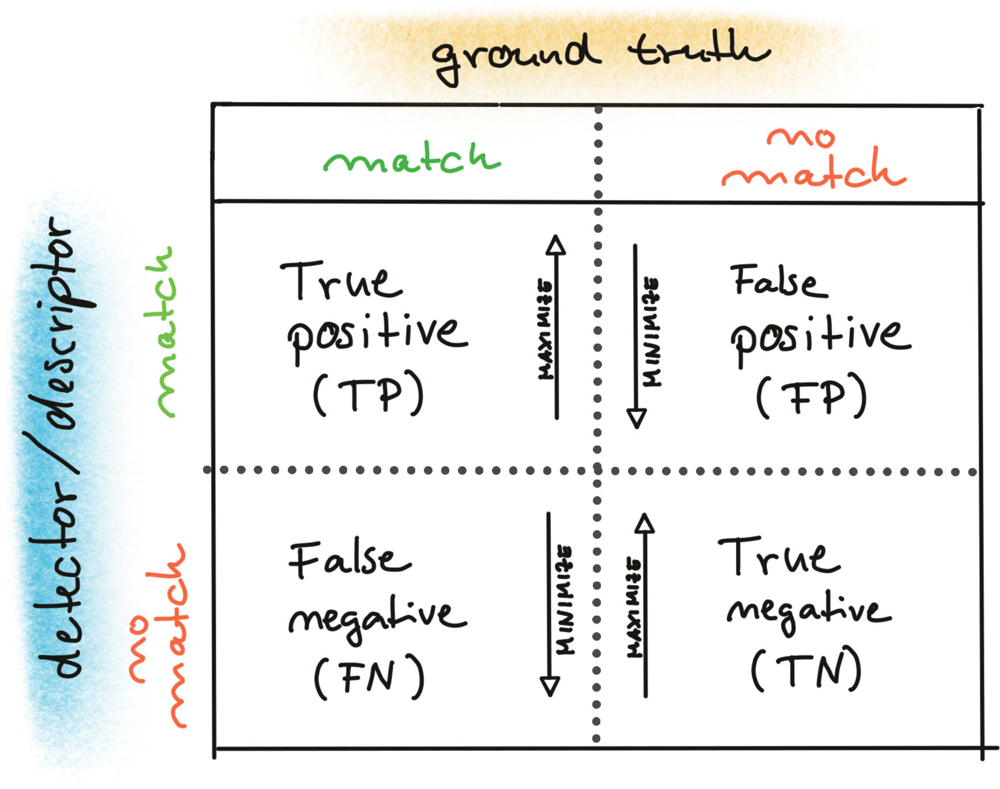

In order to decide whether a match or non-match is correct, ground-truth information of the image material used for assessment is needed. In many publications, image sequences have been used where all keypoints are located on a planar surface. In such a case, a model-based estimation can be used to differentiate between TP / TN and FP / FN. For the image sequences we use in this course, this approach can not be used as "our" keypoints are distributed in a complex three-dimensional scene, in which the objects move dynamically with unknown motion parameters. However, we can use a large number of available comparisons in the literature and transfer the results to our application scenario. At the end of this section, a small selection of such results is shown.

The ***Receiver Operating Characteristic (ROC)*** is a graphical plot that shows how well a detector / descriptor is able to differentiate between true and false matches as its discrimination threshold is varied. The ROC can be used to visually compare different detectors / descriptors and also select a suitable discrimination threshold for each. The name ROC dates back to WW II, where the method has been introduced by radar operators in the context of identifying enemy targets.

The following figure shows how the ROC is constructed from the distribution of true positives and false positives by varying the discrimination threshold on the SSD. An ideal detector / descriptor would have a TPR of 1.0 while the FPR would be close to 0.0 at the same time.

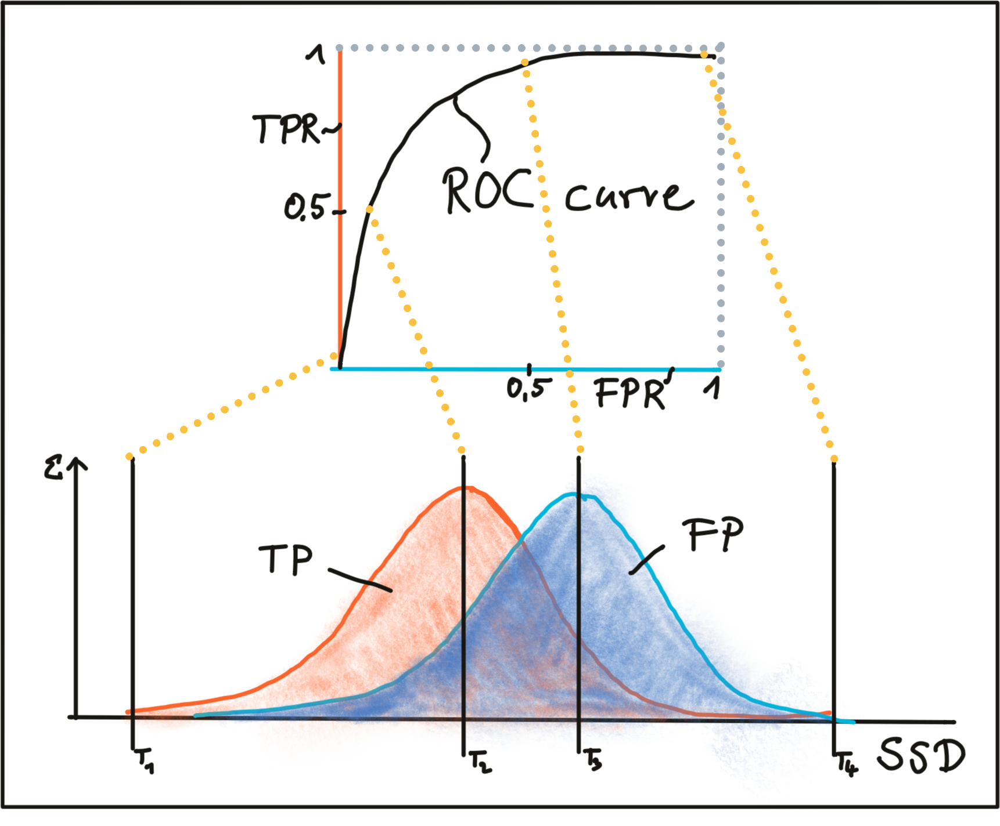

In the following figure, two examples for good and bad detectors / descriptors are shown. In the first example, there is no way of safely differentiating between TP and FP as both curves match and changes in the discrimination threshold would affect them in the same way. In the second example, the TP and FP curve do not overlap significantly and therefore, a suitable discriminator threshold can be selected.

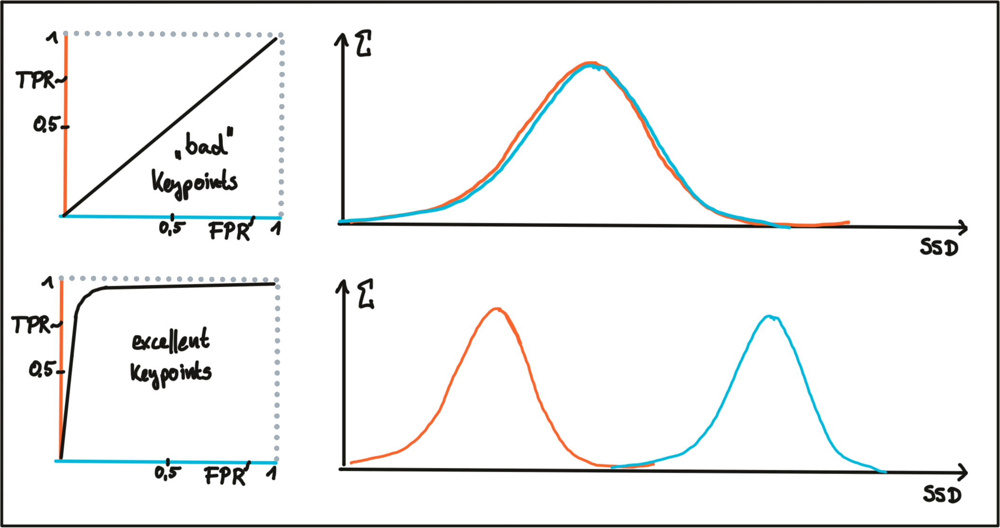

There are several other ways of assessing detectors and descriptors such as the ***Precision-Recall Curve*** which we will not discuss in this course in order to stay focused on the task ahead - which is the development of our collision avoidance system.

To conclude this section, an overview of results is given, where several descriptors have been compared against each other and which can be used to facilitate the selection process when detectors / descriptors have to be chosen for an application. In the graph, you can see the ROC curves of different descriptors such as SIFT, BRISK and several others and visually compare them against each other. Note that those results are only valid for the image sequences actually used for the comparison - for a different image set, e.g. a traffic scene, results may vary significantly.

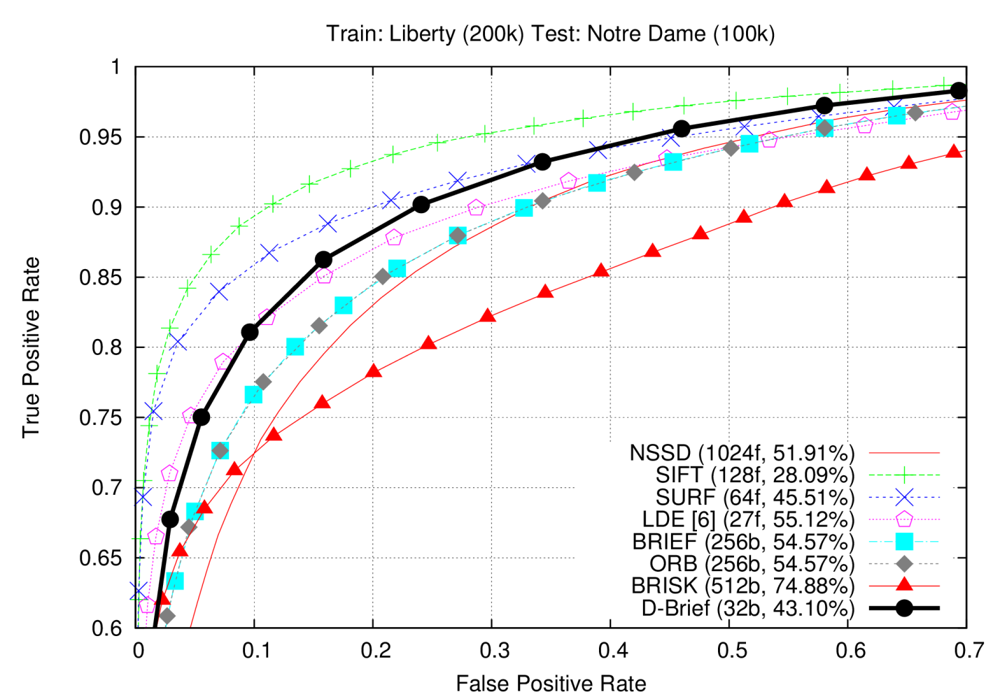
[source](https://cvlab.epfl.ch/research/page-90554-en-html/research-detect-dbrief/)

* SIFT: Performing best
* BRISK: Showing a fast increase in FP rate

## 6. Tracking an Object Across Images

### a) How do you track an object across multiple camera images and verify that it is the same object?
* Sensor Overlaping

### b) Should camera images be treated as related or each other or as individual images?
* Extremly correalted
* Corespondances

### c) What is optical flow?
* 2D vector field of the displacement of every pixel of the previous frame to the current frame
* Corespondences
* Could be used for visual odometry, tracking

### d) What is structure-from-motion?
* Process of inferring depth by moving through a scene
* Stereo / Structure-from-motion
